# **PREDICCIÓN DE LA PRODUCCIÓN DE ENERGÍA EÓLICA CON SCIKIT-LEARN**

GRUPO DE PRÁCTICAS: 82
- AITANA ANTONIA ORTIZ GUIÑO    100472097
- MARÍA PARRA MUÑOZ             100472195
ENLACE AL REPOSITORIO: https://github.com/aitanax/practica

# 1. **EDA**


Realizar un EDA simplificado:

  - Principalmente para determinar cuántas características e instancias hay, qué variables son categóricas/numéricas.

  - Si hay valores faltantes (missing values) y qué variables los tienen, si hay columnas constantes (que deberían eliminarse) y si es un problema
    de regresión o clasificación. 

  - Se puede analizar otras cuestiones que se consideren relevantes. Tenen en cuenta que la variable de respuesta es “energía”. 

  
  - Importante: de los datos originales, hay que quitar todas las variables meteorológicas que no correspondan a la localización de Sotavento (la localización  13).
  

In [284]:
import pandas as pd
import numpy as np
import numpy as df
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import copy
from sklearn import model_selection
%matplotlib inline
import time
import pickle
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsRegressor
from sklearn import tree
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression
from sklearn.dummy import DummyRegressor
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.svm import SVR
from sklearn.svm import LinearSVR
from sklearn.svm import NuSVR
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from math import sqrt
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import TimeSeriesSplit

Descomprimimos el ZIP que contiene los datos con los que trabajaremos:

In [285]:
wind_ava = pd.read_csv('wind_ava.csv.gz', compression="gzip", sep=",")

Eliminamos todas las variables no acabadas en .13

Y añadimos las variables **DATETIME** y **ENERGY**

In [286]:
sotavento_columns = [col for col in wind_ava.columns if ".13" in col]
sotavento_columns.append("datetime")
sotavento_columns.append("energy")
wind_ava_sotavento = wind_ava[sotavento_columns]

Renombramos las variables

In [287]:
wind_ava_sotavento = wind_ava_sotavento.rename(columns = {
    "energy": "Energy", 
    "datetime": "Datetime", 
    "p54.162.13": "Vertical integral of temperature", 
    "p55.162.13": "Vertical integral of water vapour", 
    "cape.13": "Convective available potential energy", 
    "p59.162.13": "Vertical integral of divergence of kinetic energy", 
    "lai_lv.13": "Leaf area index, low vegetation", 
    "lai_hv.13": "Leaf area index, high vegetation", 
    "u10n.13": "Neutral wind at 10 m u-component", 
    "v10n.13": "Neutral wind at 10 m v-component", 
    "sp.13": "Surface pressure",
    "stl1.13": "Soil temperature level 1",
    "u10.13": "10 metre U wind component",
    "v10.13": "10 metre V wind component",
    "t2m.13": "2 metre temperature", 
    "stl2.13": "Soil temperature level 2", 
    "stl3.13": "Soil temperature level 3", 
    "iews.13": "Instantaneous eastward turbulent surface stress",
    "inss.13": "Instantaneous northward turbulent surface", 
    "stl4.13": "Soil temperature level 4", 
    "fsr.13": "Forecast surface roughness", 
    "flsr.13": "Forecast logarithm of surface roughness for heat",
    "u100.13": "100 metre U wind component",
    "v100.13": "100 metre V wind component", })
wind_ava_sotavento.head()

,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,...,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Datetime,Energy
0,2.510824e+06,9.186295,13.527577,1.386937e+06,2.344111,2.432983,-0.757587,-1.922799,99846.319914,280.960661,...,281.462478,-0.057958,-0.138650,284.684755,0.404731,-5.927092,-1.780562,-4.443617,2005-01-02 18:00:00,402.71
1,2.513173e+06,8.849569,6.896412,1.153526e+06,2.343719,2.432838,-1.412620,-1.403011,99917.733093,279.296651,...,281.486541,-0.103576,-0.083050,284.667948,0.404920,-5.913881,-3.743344,-3.129469,2005-01-03 00:00:00,696.80
2,2.509627e+06,7.924080,4.774439,1.098754e+06,2.343300,2.432704,-2.290185,-0.754580,99764.378681,278.233956,...,281.487095,-0.165721,-0.036241,284.651914,0.405704,-5.908272,-5.097203,-1.157748,2005-01-03 06:00:00,1591.15
3,2.510571e+06,6.922709,0.000000,1.076021e+06,2.342830,2.432514,-3.497855,1.271028,99672.670459,280.787263,...,281.472435,-0.275550,0.098192,284.636266,0.403967,-5.961995,-4.500835,1.502478,2005-01-03 12:00:00,1338.62
4,2.505664e+06,6.646282,0.000000,1.070830e+06,2.342437,2.432369,-0.971249,0.553060,99372.811211,279.583112,...,281.473265,-0.056553,0.041844,284.620232,0.403808,-5.987860,-3.392324,2.131114,2005-01-03 18:00:00,562.50


In [288]:
duplicate_rows = wind_ava_sotavento[wind_ava_sotavento.duplicated()]
print("Número de filas duplicadas: ", duplicate_rows.shape)

Número de filas duplicadas:  (0, 24)


Aunque ya sabemos que estamosa ante un problema de regresión, lo demostramos:

In [289]:
datos = wind_ava_sotavento['Energy'].dtype

if datos == 'float64':
    print("El problema es de regresión")
elif datos == 'object':
    print("El problema es de clasificación")
else:
    print("No se puede determinar el tipo de problema")

El problema es de regresión


In [290]:
# Número de características e instancias después de filtrar por localización
print("\nDimensiones del conjunto de datos después de filtrar por localización de Sotavento:", wind_ava_sotavento.shape)


Dimensiones del conjunto de datos después de filtrar por localización de Sotavento: (4748, 24)


El objetivo principal del siguiente código es realizar un análisis temporal de los datos de energía contenidos en el DataFrame `wind_ava_sotavento`. Esto se logra a través de los siguientes pasos:

1. **Preparación de los datos temporales:** Se verifica si existe una columna de fecha y hora llamada 'Datetime'. Si esta columna existe, se convierte al tipo de datos `datetime` y se establece como el índice del DataFrame. Luego, se divide esta columna en columnas separadas de mes y año para facilitar el análisis temporal posterior.

2. **Remuestreo y agregación de datos:** Una vez que los datos están preparados, se remuestrean a nivel mensual utilizando la función `resample('M')`. Esto agrupa los datos por mes y permite calcular estadísticas resumidas, como la media mensual de la energía.

3. **Visualización de la tendencia temporal:** Finalmente, se visualiza la energía promedio por mes a lo largo del tiempo utilizando un gráfico de línea. Esto proporciona una representación gráfica de la tendencia temporal de la energía y ayuda a identificar patrones estacionales o tendencias a largo plazo.

En resumen, el objetivo del código es analizar la variación temporal de la energía y presentar esta información de manera visual para facilitar la interpretación y la identificación de tendencias temporales significativas.

La columna 'Datetime' ya ha sido eliminada.


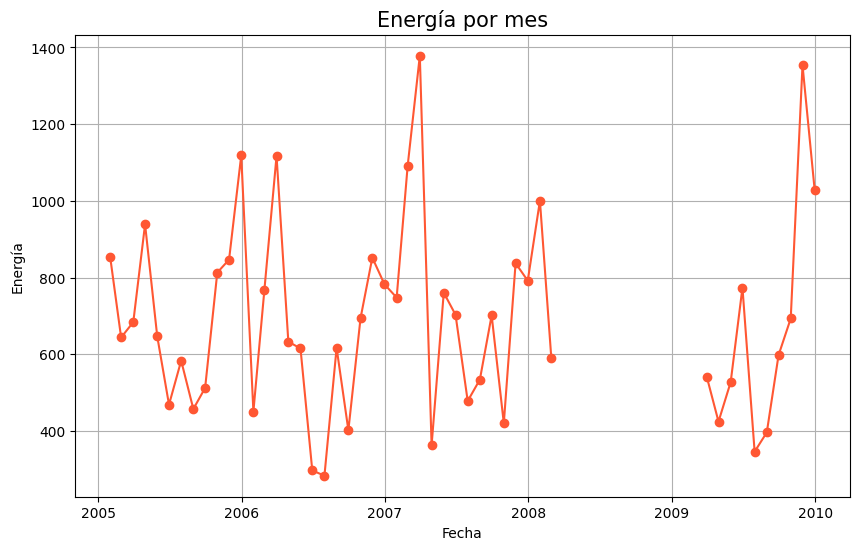

In [291]:
# Verifica si la columna 'Datetime' existe en el DataFrame
if 'Datetime' in wind_ava_sotavento.columns:
    # Convierte la columna 'Datetime' en tipo datetime y establece como índice
    wind_ava_sotavento["Datetime"] = pd.to_datetime(wind_ava_sotavento["Datetime"])
    wind_ava_sotavento.set_index('Datetime', inplace=True)

    # Dividir la columna 'Datetime' en dos nuevas columnas: 'Month' y 'Year'
    wind_ava_sotavento['Month'] = wind_ava_sotavento.index.month
    wind_ava_sotavento['Year'] = wind_ava_sotavento.index.year

    # Verifica si la columna 'Datetime' aún existe después de dividirla
    if 'Datetime' in wind_ava_sotavento.columns:
        # Eliminar la columna 'Datetime'
        wind_ava_sotavento.drop(columns=['Datetime'], inplace=True)
    else:
        print("La columna 'Datetime' ya ha sido eliminada.")

    # Ahora puedes realizar tu resampling y trazado
    date_por_mes = wind_ava_sotavento.resample('M').mean()

    plt.figure(figsize=(10, 6))
    plt.plot(date_por_mes.index, date_por_mes['Energy'], label='Energía', marker='o', color='#FF5733')
    plt.title('Energía por mes', fontsize=15)
    plt.xlabel('Fecha', fontsize=10)
    plt.ylabel('Energía', fontsize=10)
    plt.grid(True)
    plt.show()
else:
    print("La columna 'Datetime' no existe en el DataFrame.")


Mostramos el tipo de datos que hay:

In [292]:
print("\nTipos de variables:")
print(wind_ava_sotavento.dtypes)


Tipos de variables:
Vertical integral of temperature                     float64
Vertical integral of water vapour                    float64
Convective available potential energy                float64
Vertical integral of divergence of kinetic energy    float64
Leaf area index, low vegetation                      float64
Leaf area index, high vegetation                     float64
Neutral wind at 10 m u-component                     float64
Neutral wind at 10 m v-component                     float64
Surface pressure                                     float64
Soil temperature level 1                             float64
10 metre U wind component                            float64
10 metre V wind component                            float64
2 metre temperature                                  float64
Soil temperature level 2                             float64
Soil temperature level 3                             float64
Instantaneous eastward turbulent surface stress      float64
Ins

Mostramos los datos que faltan:

In [293]:
print("\nValores faltantes:")
print(wind_ava_sotavento.isnull().sum())


Valores faltantes:
Vertical integral of temperature                     0
Vertical integral of water vapour                    0
Convective available potential energy                0
Vertical integral of divergence of kinetic energy    0
Leaf area index, low vegetation                      0
Leaf area index, high vegetation                     0
Neutral wind at 10 m u-component                     0
Neutral wind at 10 m v-component                     0
Surface pressure                                     0
Soil temperature level 1                             0
10 metre U wind component                            0
10 metre V wind component                            0
2 metre temperature                                  0
Soil temperature level 2                             0
Soil temperature level 3                             0
Instantaneous eastward turbulent surface stress      0
Instantaneous northward turbulent surface            0
Soil temperature level 4                     

Eliminamos las columnas constantes en caso de existir:

In [294]:
const_cols = [col for col in wind_ava_sotavento.columns if wind_ava_sotavento[col].nunique() == 1]
if const_cols:
    wind_ava_sotavento.drop(const_cols, axis=1, inplace=True)
    print("\nColumnas constantes eliminadas:", const_cols)

Este código genera tres subgráficos utilizando `matplotlib` y `seaborn`, cada uno mostrando la distribución de la variable "Energía" de `wind_ava_sotavento` con diferentes transformaciones:

1. **Distribución original**: Muestra la distribución de la variable "Energía" sin ninguna transformación.
2. **Transformación raíz cuadrada**: Muestra la distribución de la raíz cuadrada de la variable "Energía".
3. **Transformación logarítmica**: Muestra la distribución del logaritmo natural de la variable "Energía".

Cada subgráfico utiliza un kernel density estimate (KDE) plot (`sns.kdeplot`) para visualizar la distribución de la variable y un rugplot (`sns.rugplot`) para mostrar la distribución de los puntos de datos a lo largo del eje x. El rugplot es una representación gráfica de la distribución de los datos.

El objetivo de este tipo de visualización es explorar cómo se distribuyen los datos y si alguna transformación puede hacer que la distribución sea más simétrica o normal, lo que puede ser útil para ciertos tipos de modelos de regresión.

Además, `fig.tight_layout()` se utiliza para ajustar automáticamente los espacios entre los subgráficos para que no se superpongan. Esto garantiza que los subgráficos sean legibles y estén bien distribuidos en la figura.

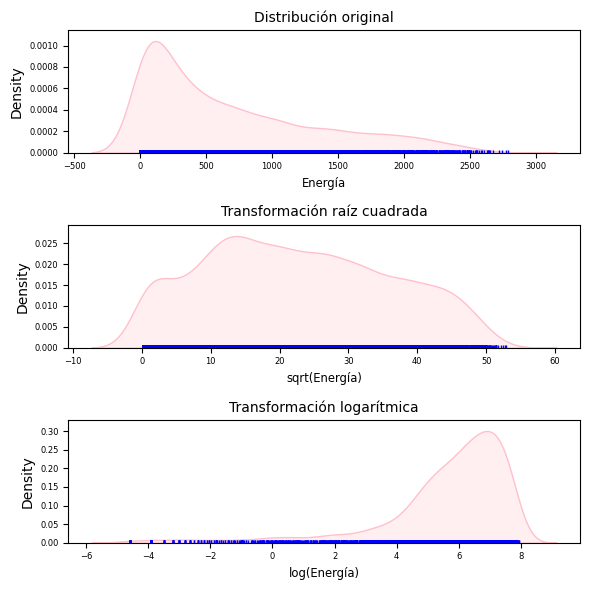

In [295]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(6, 6))
sns.kdeplot(wind_ava_sotavento['Energy'], fill = True, color = "pink", ax = axes[0])
sns.rugplot(wind_ava_sotavento['Energy'], color = "blue", ax = axes[0])
axes[0].set_title("Distribución original", fontsize = 'medium')
axes[0].set_xlabel('Energía', fontsize='small')
axes[0].tick_params(labelsize = 6)

sns.kdeplot(np.sqrt(wind_ava_sotavento['Energy']), fill = True, color = "pink", ax = axes[1])
sns.rugplot(np.sqrt(wind_ava_sotavento['Energy']), color = "blue", ax = axes[1])
axes[1].set_title("Transformación raíz cuadrada", fontsize = 'medium')
axes[1].set_xlabel('sqrt(Energía)', fontsize='small')
axes[1].tick_params(labelsize = 6)

sns.kdeplot(np.log(wind_ava_sotavento['Energy']), fill = True, color = "pink", ax = axes[2])
sns.rugplot(np.log(wind_ava_sotavento['Energy']), color = "blue", ax = axes[2])
axes[2].set_title("Transformación logarítmica", fontsize = 'medium')
axes[2].set_xlabel('log(Energía)', fontsize='small')
axes[2].tick_params(labelsize = 6)

fig.tight_layout()

El código calcula la matriz de correlación entre las correlaciones entre pares de variables en el conjunto de datos `wind_ava_sotavento`. Luego, utilizamos `sns.heatmap` de Seaborn para visualizar esta matriz de correlación como un mapa de calor.

Aquí está lo que hace paso a paso:

1. `correlaciones = wind_ava_sotavento.corr()`: Calcula la matriz de correlación entre las variables en `wind_ava_sotavento`. Esta matriz es cuadrada y simétrica, donde cada entrada indica la correlación entre dos variables.

2. `plt.figure(figsize=(20, 16))`: Crea una nueva figura de matplotlib con el tamaño especificado (20 unidades de ancho y 16 unidades de alto). Esto establece el tamaño de la figura en la que se mostrará el mapa de calor.

3. `sns.heatmap(correlaciones.corr().abs(), fmt=".2f", annot=True, cmap="BLues")`: Crea un mapa de calor de la matriz de correlación. Los parámetros `fmt=".2f"` y `annot=True` se utilizan para mostrar los valores de correlación en el mapa de calor con dos decimales y para anotar los valores en las celdas del mapa de calor, respectivamente. El parámetro `cmap="Blues"` especifica el mapa de colores que se utilizará para representar los valores de correlación.

El objetivo de este mapa el observar una posible correlación alta entre dos variables, y poder prescindir de una de ellas.


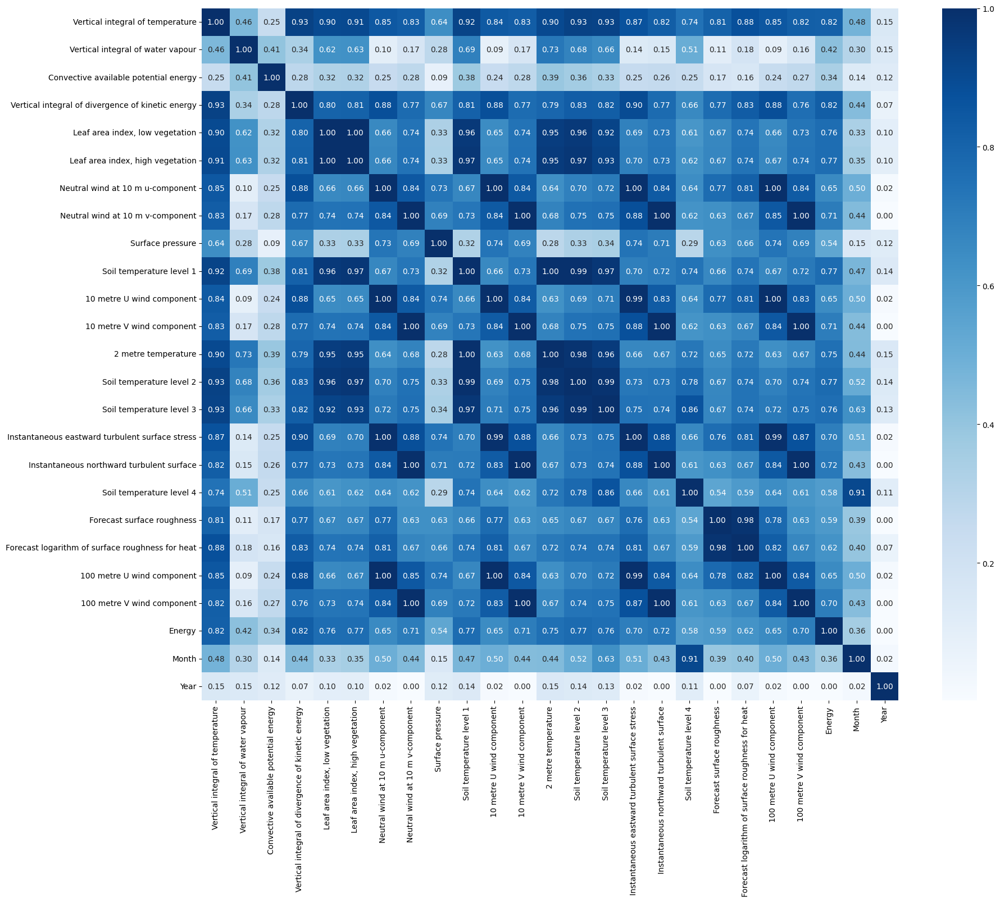

In [296]:
correlaciones = wind_ava_sotavento.corr()
plt.figure(figsize=(20, 16))
plot = sns.heatmap(correlaciones.corr().abs(), fmt=".2f", annot=True, cmap="Blues")

A continuación:

Este código crea un conjunto de gráficos de dispersión para visualizar las relaciones entre una columna específica del conjunto de datos (`columna_interes`) y todas las demás columnas en el conjunto de datos `wind_ava_sotavento`.

Aquí está lo que hace paso a paso:

1. `columna_interes = '[atributo]'`: Selecciona la columna específica del conjunto de datos que se utilizará como la columna de interés para comparar con todas las demás columnas.

2. `fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))`: Crea una figura y un conjunto de subgráficos con una cuadrícula de 6 filas y 5 columnas. Esto creará un total de 30 subgráficos, cada uno para una columna diferente en el conjunto de datos `wind_ava_sotavento`. La figura tiene un tamaño de 24 pulgadas de ancho y 30 pulgadas de alto.

3. `axes = axes.flat`: Aplanar el conjunto de subgráficos en una lista plana para facilitar la iteración sobre ellos.

4. `for i, columna in enumerate(wind_ava_sotavento.columns):`: Itera sobre cada columna en el conjunto de datos `wind_ava_sotavento`. El bucle `for` recorre todas las columnas y su índice `i`.

5. `sns.scatterplot(x=wind_ava_sotavento[columna_interes], y=wind_ava_sotavento[columna], color='#a0f207', ax=axes[i])`: Para cada columna en el conjunto de datos, crea un gráfico de dispersión (`scatterplot`) que compara los valores de la columna de interés (`columna_interes`) en el eje x y los valores de la columna actual en el eje y. El color de los puntos del gráfico de dispersión se establece en `'#a0f207'`.

6. `axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')`: Establece el título de cada subgráfico para indicar qué columnas se están comparando.

7. `axes[i].set_xlabel(columna_interes)`: Establece la etiqueta del eje x para indicar la columna de interés.

8. `axes[i].set_ylabel(columna)`: Establece la etiqueta del eje y para indicar la columna actual.

9. `plt.tight_layout()`: Ajusta automáticamente el diseño de los subgráficos para evitar que se superpongan.

10. `plt.show()`: Muestra la figura con los gráficos de dispersión.

En resumen, este código crea un conjunto de gráficos de dispersión para explorar visualmente las relaciones entre una columna específica del conjunto de datos y todas las demás columnas. Cada gráfico de dispersión compara la columna de interés con una columna diferente en el conjunto de datos.

Se ha realizado un conjunto de graficos de disperacios para las 22 varaibles, sin emebargo al final del todo se observan en grande las 3 de mayor correlación que hemos eliminado.

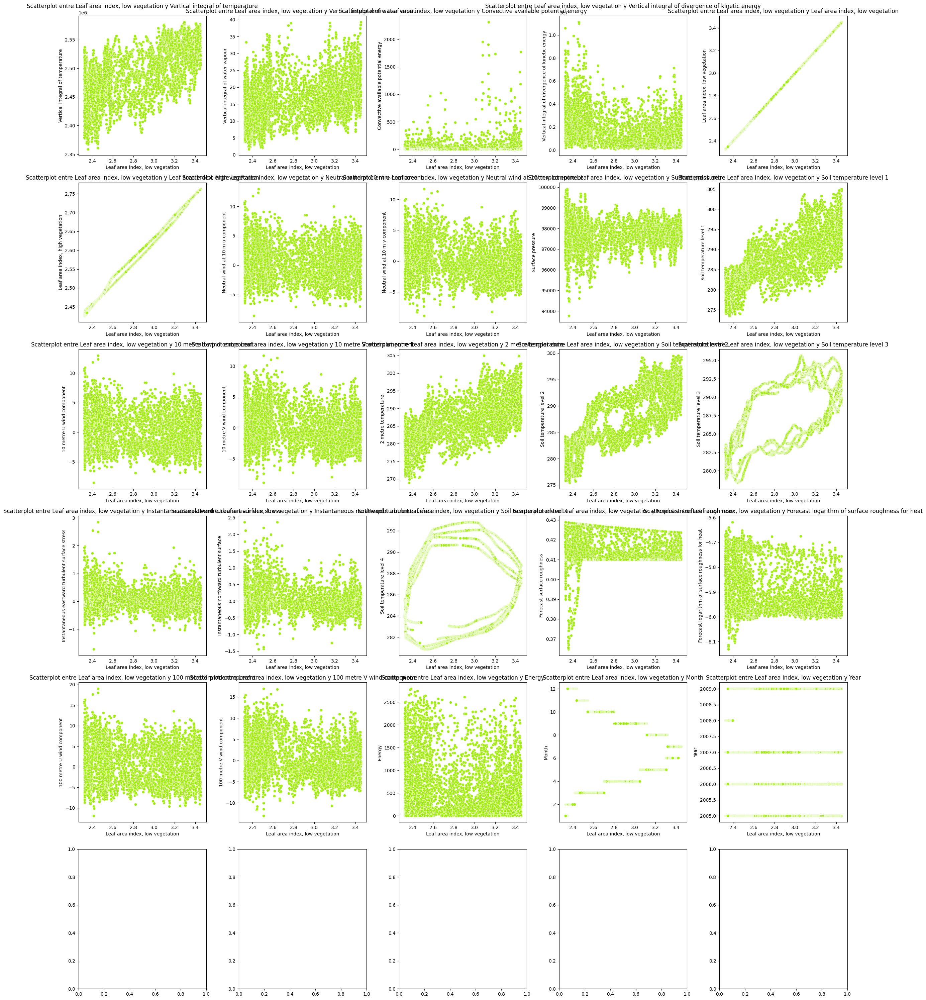

In [297]:
# Columna de interés
columna_interes = 'Leaf area index, low vegetation'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

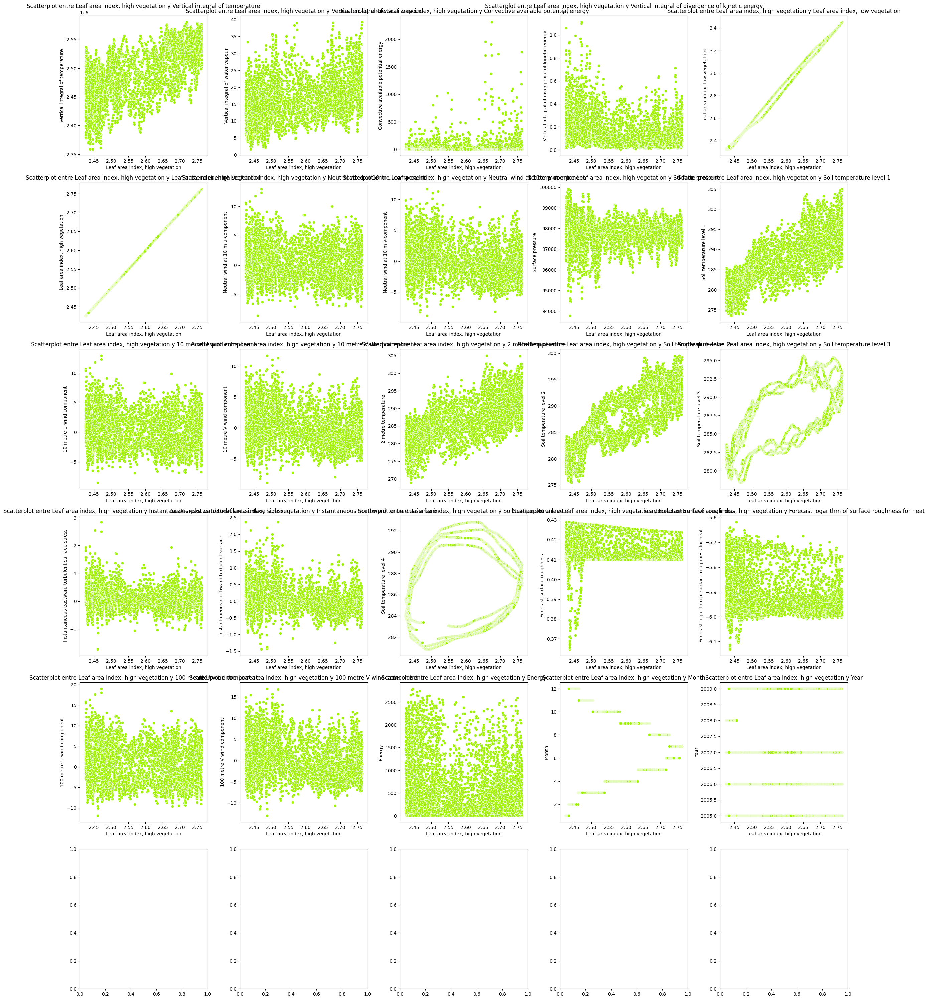

In [298]:
# Columna de interés
columna_interes = 'Leaf area index, high vegetation'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

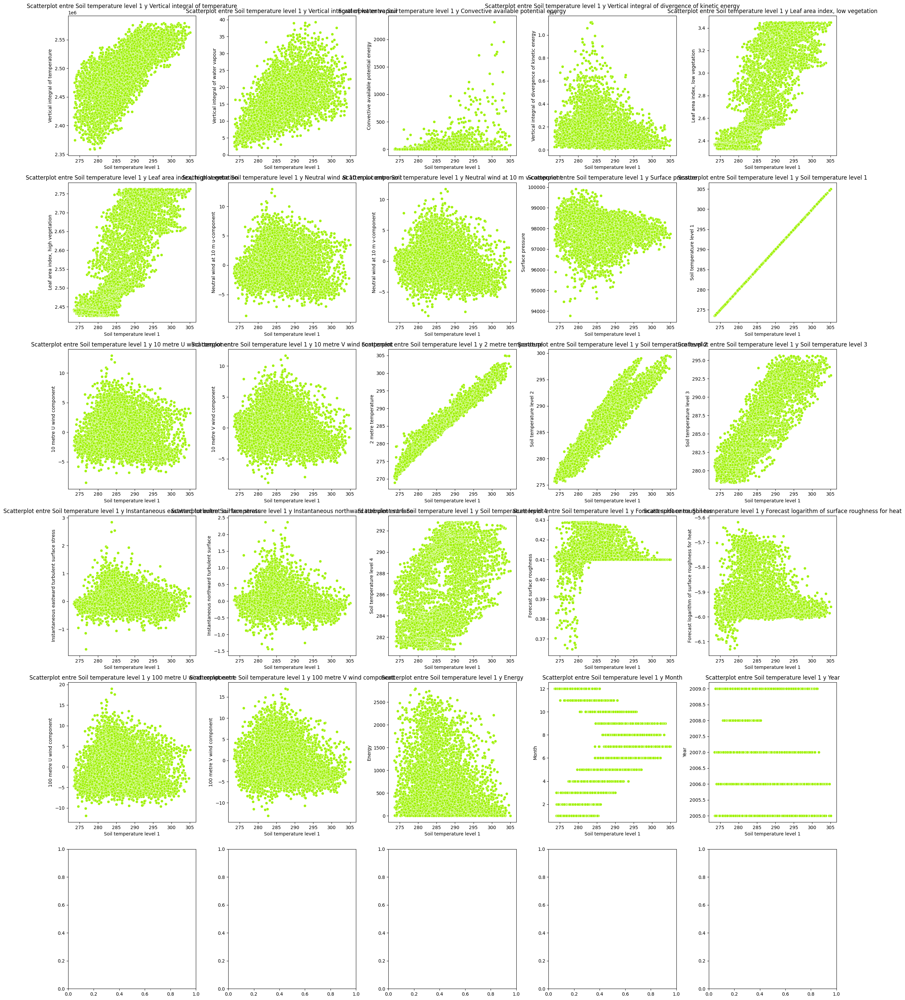

In [299]:
# Columna de interés
columna_interes = 'Soil temperature level 1'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

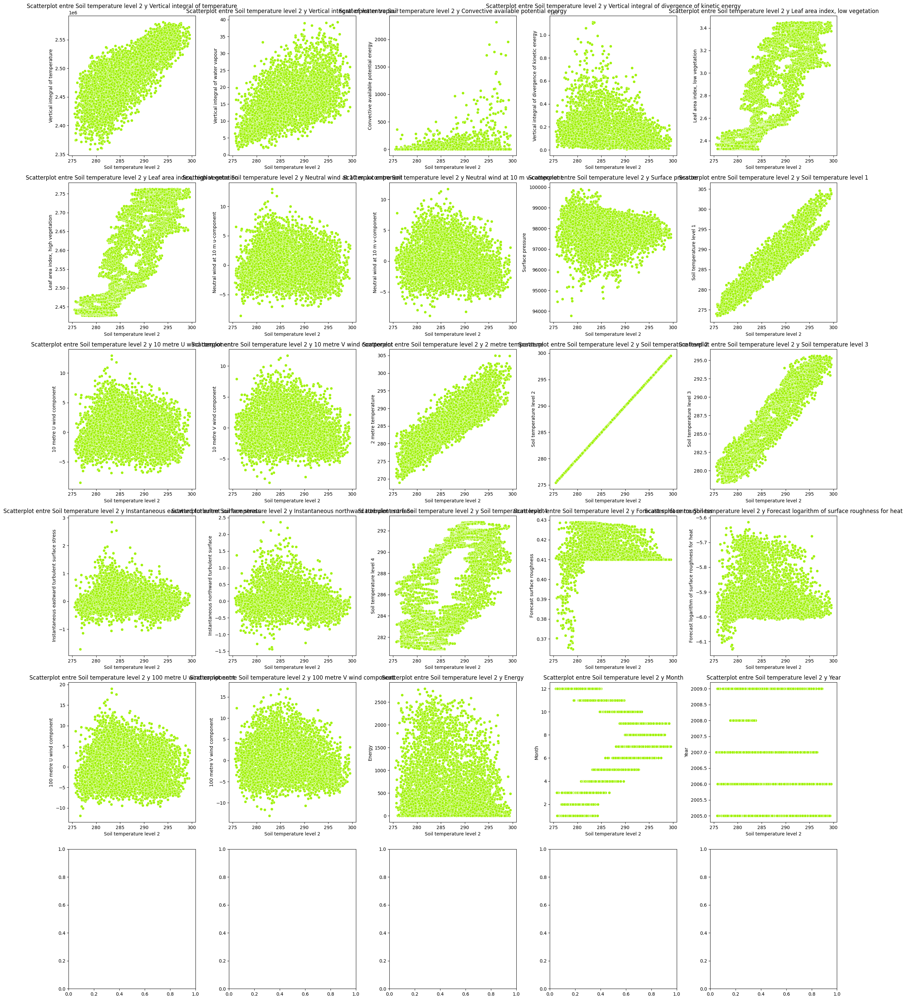

In [300]:
# Columna de interés
columna_interes = 'Soil temperature level 2'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

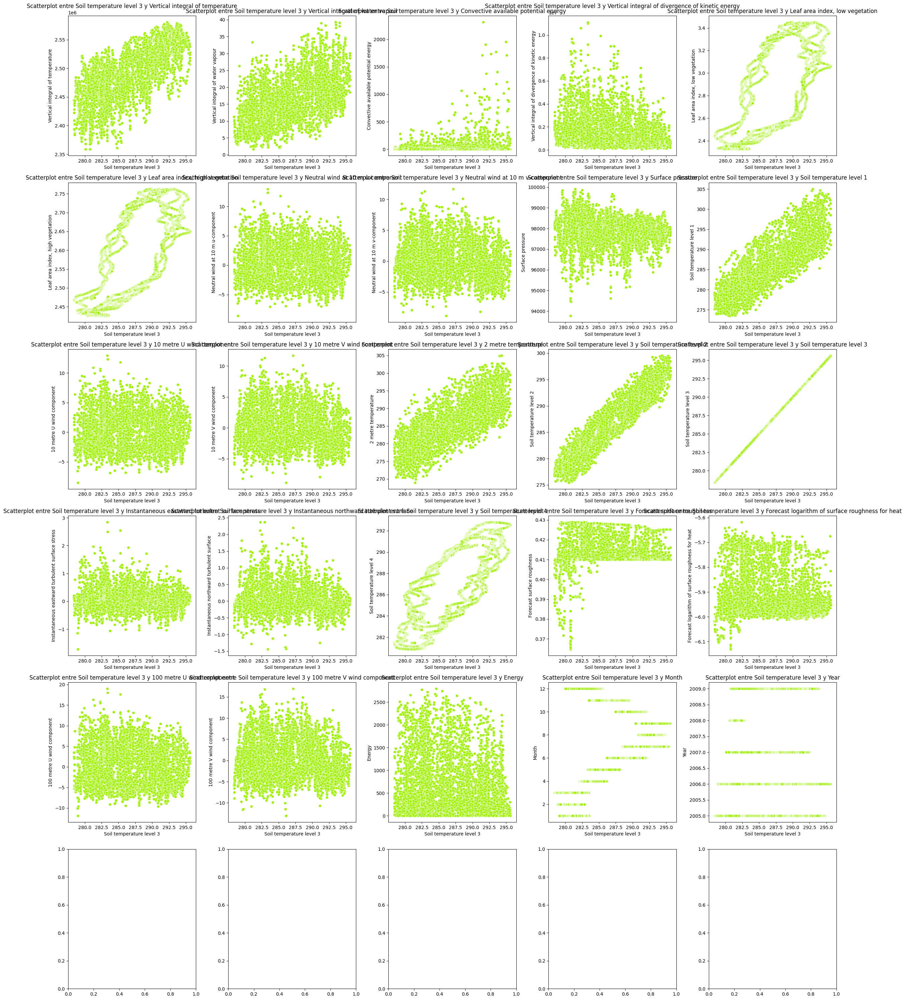

In [301]:
# Columna de interés
columna_interes = 'Soil temperature level 3'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

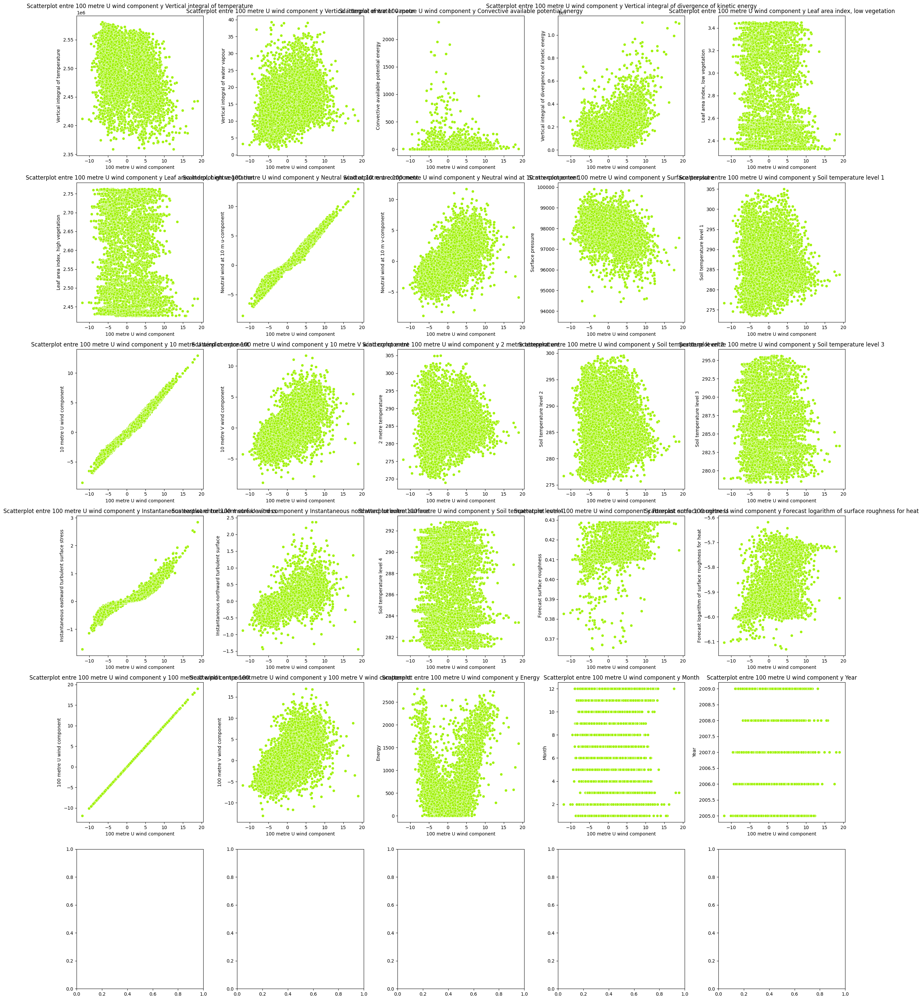

In [302]:
# Columna de interés
columna_interes = '100 metre U wind component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

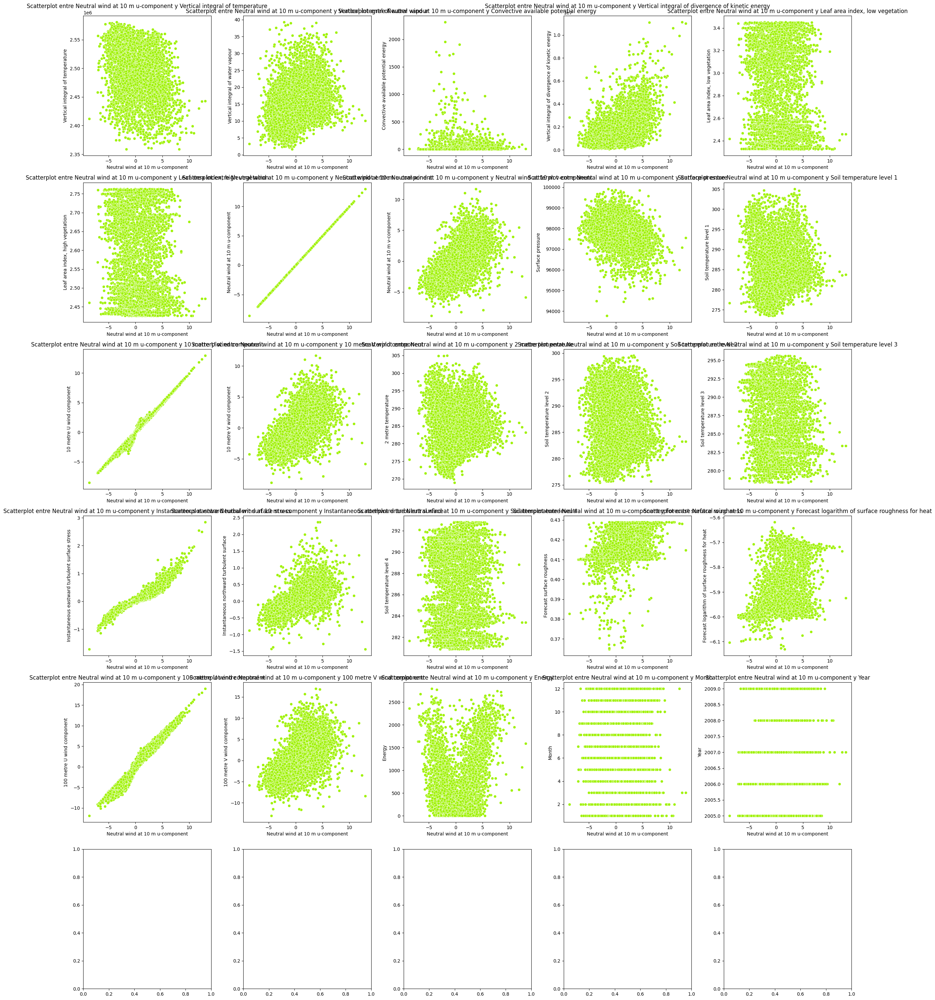

In [303]:
# Columna de interés
columna_interes = 'Neutral wind at 10 m u-component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

Finalmente, en esta sección mostramos los 3 pares de variables que guardan una alta correlación:


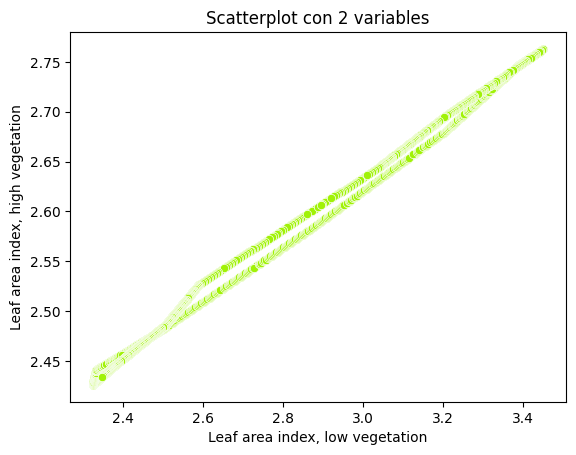

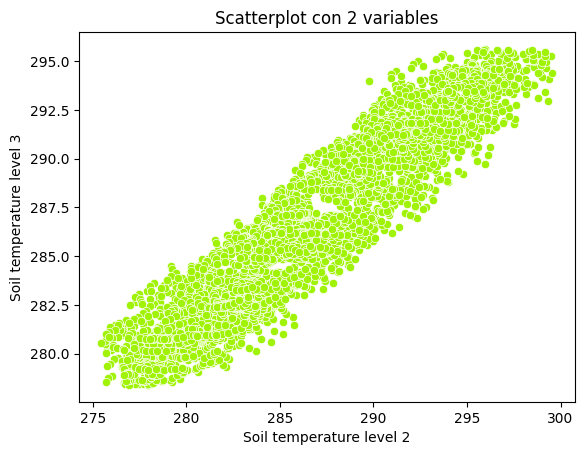

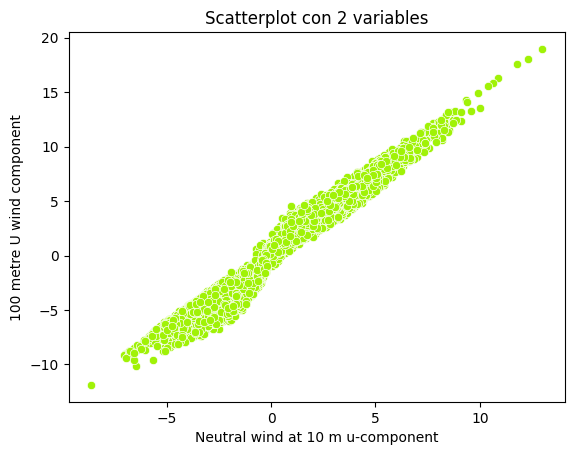

In [304]:
sns.scatterplot(x=wind_ava_sotavento['Leaf area index, low vegetation'], 
                y=wind_ava_sotavento['Leaf area index, high vegetation'], 
                color='#a0f207')
plt.title('Scatterplot con 2 variables')
plt.xlabel('Leaf area index, low vegetation')
plt.ylabel('Leaf area index, high vegetation')
plt.show()

sns.scatterplot(x=wind_ava_sotavento['Soil temperature level 2'], 
                y=wind_ava_sotavento['Soil temperature level 3'], 
                color='#a0f207')
plt.title('Scatterplot con 2 variables')
plt.xlabel('Soil temperature level 2')
plt.ylabel('Soil temperature level 3')
plt.show()

sns.scatterplot(x=wind_ava_sotavento['Neutral wind at 10 m u-component'], 
                y=wind_ava_sotavento['100 metre U wind component'], 
                color='#a0f207')
plt.title('Scatterplot con 2 variables')
plt.xlabel('Neutral wind at 10 m u-component')
plt.ylabel('100 metre U wind component')
plt.show()

Procedemos a su eliminación:

In [305]:
wind_ava_sotavento.drop(columns=['Leaf area index, low vegetation'], inplace=True)
wind_ava_sotavento.drop(columns=['Soil temperature level 2'], inplace=True)
wind_ava_sotavento.drop(columns=['Neutral wind at 10 m u-component'], inplace=True)

Y cargamos otra vez el heatmap:

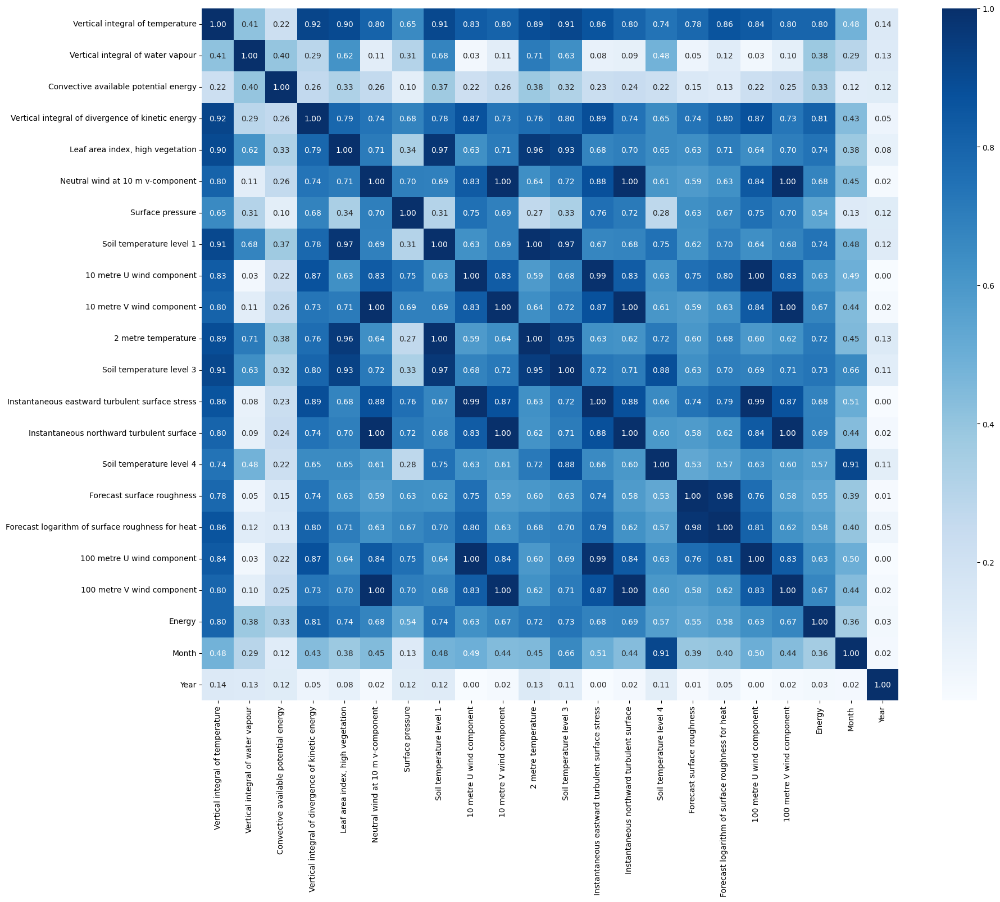

In [306]:
correlaciones = wind_ava_sotavento.corr()
plt.figure(figsize=(20, 16))
plot = sns.heatmap(correlaciones.corr().abs(), fmt=".2f", annot=True, cmap="Blues")

Realizar la eliminación de datos correlacionados hará que los resultados del KNN sea mejor.

In [307]:
wind_ava_sotavento.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4748 entries, 2005-01-02 18:00:00 to 2009-12-31 18:00:00
Data columns (total 22 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Vertical integral of temperature                   4748 non-null   float64
 1   Vertical integral of water vapour                  4748 non-null   float64
 2   Convective available potential energy              4748 non-null   float64
 3   Vertical integral of divergence of kinetic energy  4748 non-null   float64
 4   Leaf area index, high vegetation                   4748 non-null   float64
 5   Neutral wind at 10 m v-component                   4748 non-null   float64
 6   Surface pressure                                   4748 non-null   float64
 7   Soil temperature level 1                           4748 non-null   float64
 8   10 metre U wind component                          4

HEMOS FINALIZADO EL EDA

# 2. **EVALUACIÓN.** OUTER / INNER

Volvemos a cargar los datos:

In [308]:
wind_ava = pd.read_csv('wind_ava.csv.gz', compression="gzip", sep=",")

In [309]:
sotavento_columns = [col for col in wind_ava.columns if ".13" in col]
sotavento_columns.insert(0, "datetime")
sotavento_columns.append("energy")
wind_ava_sotavento = wind_ava[sotavento_columns]

In [310]:
wind_ava_sotavento = wind_ava_sotavento.rename(columns = {
    "energy": "Energy", 
    "datetime": "Datetime", 
    "p54.162.13": "Vertical integral of temperature", 
    "p55.162.13": "Vertical integral of water vapour", 
    "cape.13": "Convective available potential energy", 
    "p59.162.13": "Vertical integral of divergence of kinetic energy", 
    "lai_lv.13": "Leaf area index, low vegetation", 
    "lai_hv.13": "Leaf area index, high vegetation", 
    "u10n.13": "Neutral wind at 10 m u-component", 
    "v10n.13": "Neutral wind at 10 m v-component", 
    "sp.13": "Surface pressure",
    "stl1.13": "Soil temperature level 1",
    "u10.13": "10 metre U wind component",
    "v10.13": "10 metre V wind component",
    "t2m.13": "2 metre temperature", 
    "stl2.13": "Soil temperature level 2", 
    "stl3.13": "Soil temperature level 3", 
    "iews.13": "Instantaneous eastward turbulent surface stress",
    "inss.13": "Instantaneous northward turbulent surface", 
    "stl4.13": "Soil temperature level 4", 
    "fsr.13": "Forecast surface roughness", 
    "flsr.13": "Forecast logarithm of surface roughness for heat",
    "u100.13": "100 metre U wind component",
    "v100.13": "100 metre V wind component", })
wind_ava_sotavento.head()

,Datetime,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,...,Soil temperature level 2,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
0,2005-01-02 18:00:00,2.510824e+06,9.186295,13.527577,1.386937e+06,2.344111,2.432983,-0.757587,-1.922799,99846.319914,...,281.042026,281.462478,-0.057958,-0.138650,284.684755,0.404731,-5.927092,-1.780562,-4.443617,402.71
1,2005-01-03 00:00:00,2.513173e+06,8.849569,6.896412,1.153526e+06,2.343719,2.432838,-1.412620,-1.403011,99917.733093,...,280.747406,281.486541,-0.103576,-0.083050,284.667948,0.404920,-5.913881,-3.743344,-3.129469,696.80
2,2005-01-03 06:00:00,2.509627e+06,7.924080,4.774439,1.098754e+06,2.343300,2.432704,-2.290185,-0.754580,99764.378681,...,280.114863,281.487095,-0.165721,-0.036241,284.651914,0.405704,-5.908272,-5.097203,-1.157748,1591.15
3,2005-01-03 12:00:00,2.510571e+06,6.922709,0.000000,1.076021e+06,2.342830,2.432514,-3.497855,1.271028,99672.670459,...,279.991138,281.472435,-0.275550,0.098192,284.636266,0.403967,-5.961995,-4.500835,1.502478,1338.62
4,2005-01-03 18:00:00,2.505664e+06,6.646282,0.000000,1.070830e+06,2.342437,2.432369,-0.971249,0.553060,99372.811211,...,280.576898,281.473265,-0.056553,0.041844,284.620232,0.403808,-5.987860,-3.392324,2.131114,562.50


Eliminar o no los datos correlaciones puede influir tanto positiva como negativamente, dado que puede pasar que para ciertos modelos sea algo bueno pero para otros no lo sea, entonces nosotras hemos decidido que **NO** los borraremos:

In [311]:
#wind_ava_sotavento.drop(columns=['Leaf area index, low vegetation'], inplace=True)
#wind_ava_sotavento.drop(columns=['Soil temperature level 2'], inplace=True)
#wind_ava_sotavento.drop(columns=['Neutral wind at 10 m u-component'], inplace=True)

Lo primero que haremos después de mostrar los datos con los que trabajamos será el entrenamiento de los modelos para observar qué modelo es mejor.
Además, sabemos que debido a la categoría de los datos los métodos que utilizaremos son del tipo de regresión, esto es debido a que a variable de salida se corresponde con valores númericos.

Para el entrenamiento de datos, tendremos que obtener los datos que vamos a utilizar para su entrenamiento, para ellos lo primero que haremos es dividir los datos por años:

In [312]:
import pandas as pd

# Copia del dataframe original
dataset_sotavento_copy = wind_ava_sotavento.copy()

# Convertir 'Datetime' a tipo datetime
dataset_sotavento_copy["Datetime"] = pd.to_datetime(dataset_sotavento_copy["Datetime"])

# Crear la columna 'Year'
dataset_sotavento_copy['Year'] = dataset_sotavento_copy['Datetime'].dt.year
# Crear la columna 'Month'
dataset_sotavento_copy['Month'] = dataset_sotavento_copy['Datetime'].dt.month

# Separar los datos por año
dfs_per_year = {}
years = [2005, 2006, 2007, 2008, 2009]
for year in years:
    dfs_per_year[year] = dataset_sotavento_copy[dataset_sotavento_copy["Year"] == year].copy()  # Copia del DataFrame

# Eliminar las columnas 'Datetime' y 'Year'
for df in dfs_per_year.values():
    df.drop(columns=['Datetime', 'Year', 'Month'], inplace=True)

# Imprimir los datos por años
for year, df in dfs_per_year.items():
    print(f"Año {year}")
    display(df.describe())



Año 2005


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,...,Soil temperature level 2,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.256000e+03,1256.000000,1256.000000,1.256000e+03,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,...,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000
mean,2.490163e+06,14.974897,18.695572,1.637962e+06,2.804886,2.573296,0.081905,-0.154809,97929.057902,286.423128,...,286.427246,286.451280,0.030567,0.011607,286.474023,0.412472,-5.920952,-0.044670,-0.119119,718.697078
std,4.565748e+04,6.264040,64.414358,1.251384e+06,0.393876,0.115452,3.011221,3.057194,692.248988,6.841428,...,5.974203,4.987448,0.342333,0.375015,3.884430,0.007755,0.088826,4.706345,4.781159,669.357880
min,2.360347e+06,2.455159,0.000000,5.610341e+04,2.323973,2.425866,-8.619823,-8.867441,95326.740861,273.558807,...,275.686673,278.389271,-1.714897,-1.430244,280.875389,0.371716,-6.103557,-11.879053,-13.043453,0.010000
25%,2.458392e+06,10.162259,0.000000,7.261740e+05,2.433286,2.464016,-2.186774,-2.426593,97472.656174,280.963956,...,281.193589,282.135770,-0.153119,-0.189803,282.698597,0.410021,-5.980925,-4.058791,-3.825583,173.177500
50%,2.489520e+06,14.550201,0.530493,1.292338e+06,2.707414,2.544660,-0.400314,-0.416457,97934.146407,285.764337,...,285.838105,285.694741,-0.011060,-0.019718,286.321687,0.410461,-5.957047,-0.610321,-0.887834,515.745000
75%,2.526095e+06,19.050102,11.386658,2.216000e+06,3.193420,2.686188,2.194124,1.815414,98396.112305,291.302545,...,291.478219,291.375789,0.193661,0.155802,290.397982,0.414842,-5.884128,3.773504,3.182208,1098.310000
max,2.580387e+06,39.085819,1065.571442,7.256923e+06,3.450745,2.762992,8.513041,11.029826,99917.733093,305.043177,...,299.316962,294.813820,1.385272,1.996405,292.107406,0.428914,-5.642137,12.437051,15.708148,2774.890000


Año 2006


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,...,Soil temperature level 2,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.272000e+03,1272.000000,1272.000000,1.272000e+03,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,...,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000
mean,2.487344e+06,16.758575,49.004104,1.587265e+06,2.816685,2.576766,0.472461,0.319202,97705.717291,287.218516,...,287.129565,287.021828,0.091683,0.082824,286.872875,0.414316,-5.900938,0.584713,0.658971,635.094505
std,4.690659e+04,6.817038,159.395618,1.452486e+06,0.393224,0.115233,3.094786,3.032263,742.509828,7.029698,...,6.139600,5.159529,0.377380,0.395288,4.106931,0.006934,0.096701,4.782416,4.670299,656.110591
min,2.358748e+06,3.863718,0.000000,1.076542e+05,2.323973,2.425866,-7.035103,-8.240219,94625.420310,274.024243,...,275.789519,278.877455,-1.051791,-1.087586,281.130390,0.389964,-6.042348,-9.327751,-11.621539,0.010000
25%,2.455445e+06,11.406520,0.000000,5.631536e+05,2.437680,2.465189,-1.833751,-1.855000,97393.283533,281.783413,...,282.373035,282.547615,-0.104567,-0.123285,282.702413,0.410027,-5.974493,-3.479948,-2.887868,97.842500
50%,2.483866e+06,16.328007,1.174664,1.018206e+06,2.747297,2.557526,0.119239,0.005979,97813.200640,286.693434,...,286.815724,286.761830,0.010468,0.007264,286.949530,0.410955,-5.941832,0.377086,-0.080337,393.630000
75%,2.523643e+06,21.645502,22.005996,2.148206e+06,3.206634,2.689210,2.662387,2.182917,98154.791569,291.982953,...,292.552982,291.607296,0.237874,0.181881,291.077743,0.417799,-5.842011,4.001981,3.917612,999.672500
max,2.576637e+06,39.230807,1955.587516,9.935953e+06,3.450745,2.762992,11.789312,11.283636,99433.696337,304.701958,...,299.556292,295.639998,2.542981,2.365432,292.808658,0.428877,-5.651477,17.591969,16.810755,2552.410000


Año 2007


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,...,Soil temperature level 2,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.121000e+03,1121.000000,1121.000000,1.121000e+03,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,...,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000
mean,2.494287e+06,15.852817,29.594721,1.686279e+06,2.828723,2.580291,0.172899,-0.172810,97939.707855,286.377288,...,286.428672,286.456949,0.057332,0.017632,286.633910,0.413936,-5.913958,0.078229,-0.176747,707.736753
std,3.828857e+04,6.025432,139.529492,1.425241e+06,0.407690,0.119386,3.199306,2.972529,640.985674,5.660083,...,4.772764,3.698411,0.392778,0.364170,2.522157,0.006155,0.089093,5.020173,4.564424,653.687550
min,2.383413e+06,2.050003,0.000000,8.044683e+04,2.323973,2.425866,-6.947494,-8.174159,95781.096119,273.498473,...,275.461648,280.122669,-1.014437,-1.438829,282.984942,0.397906,-6.044017,-9.579899,-10.682077,0.010000
25%,2.466970e+06,11.794737,0.000000,6.797246e+05,2.411873,2.458100,-2.198141,-2.277089,97554.248586,282.438598,...,282.785774,283.207216,-0.160597,-0.175920,284.351515,0.410067,-5.979378,-4.331341,-3.615913,160.140000
50%,2.496863e+06,15.601708,0.947309,1.259492e+06,2.822238,2.577547,-0.318065,-0.514678,97947.338185,286.054093,...,286.157663,286.224552,-0.011018,-0.026088,286.201431,0.411007,-5.949619,-0.491048,-1.100373,476.100000
75%,2.525644e+06,19.769118,12.997084,2.270102e+06,3.224025,2.693531,2.358252,1.635749,98350.067928,290.625305,...,290.266102,289.847069,0.213846,0.131034,289.130657,0.416842,-5.871491,3.822155,3.029165,1131.960000
max,2.572801e+06,37.053944,2311.662152,1.110694e+07,3.450745,2.762992,12.974802,10.064655,99869.786056,301.828220,...,296.572977,292.474687,2.842552,2.114690,290.680560,0.428907,-5.638938,18.964137,15.483136,2547.090000


Año 2008


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,...,Soil temperature level 2,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.780000e+02,178.000000,178.000000,1.780000e+02,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,...,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000
mean,2.460094e+06,12.701343,7.956760,2.161641e+06,2.337015,2.434911,1.239803,1.884995,98026.528043,281.207589,...,281.368603,281.774548,0.211589,0.252818,283.655221,0.416875,-5.871055,1.807892,3.246931,829.901685
std,3.837994e+04,4.998415,17.979383,1.854272e+06,0.016130,0.007730,2.936134,2.639466,909.588613,2.308184,...,1.272842,0.636825,0.408903,0.404169,0.614306,0.007423,0.108828,4.925812,4.083952,738.224964
min,2.369388e+06,5.247886,0.000000,2.069968e+05,2.323973,2.425866,-3.960296,-4.866640,94990.857913,275.728307,...,278.443804,280.561620,-0.464135,-0.448602,282.696134,0.409885,-5.997571,-6.921878,-7.102347,0.020000
25%,2.433615e+06,8.851940,0.000000,8.677596e+05,2.327210,2.428905,-0.990841,0.195206,97580.949251,279.847011,...,280.489324,281.175929,-0.050583,0.022306,283.112974,0.410586,-5.964383,-2.524452,0.504893,155.215000
50%,2.462686e+06,11.646361,0.378924,1.533624e+06,2.330472,2.432911,0.470044,1.080149,98116.928631,281.155100,...,281.200549,281.710580,0.037119,0.089709,283.733138,0.412877,-5.913035,1.604086,2.824359,613.125000
75%,2.492874e+06,15.517865,9.255212,3.013068e+06,2.340371,2.438279,3.436541,3.689258,98726.445828,282.986804,...,282.255400,282.338650,0.432553,0.426048,284.151426,0.425432,-5.759189,5.876223,6.109355,1443.222500
max,2.517141e+06,33.361473,138.079810,1.058803e+07,2.396260,2.456368,10.629698,9.827882,99537.327896,286.025194,...,283.730722,282.799797,1.936731,2.366522,284.826551,0.428914,-5.618172,15.804435,14.878947,2363.490000


Año 2009


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,...,Soil temperature level 2,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,9.210000e+02,921.000000,921.000000,9.210000e+02,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,...,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000
mean,2.491311e+06,17.212382,29.936909,1.902282e+06,2.903283,2.602138,0.776766,0.237646,97645.045487,287.642488,...,287.652903,287.667133,0.103685,0.057073,287.274131,0.413506,-5.902387,1.114046,0.531916,694.184886
std,4.702051e+04,6.996512,105.880987,1.677312e+06,0.367089,0.107201,3.065628,2.920629,680.278946,5.729230,...,4.812721,3.873542,0.332460,0.357538,3.345873,0.009401,0.098398,4.740274,4.483053,667.122141
min,2.358888e+06,1.650268,0.000000,1.130241e+05,2.347406,2.434145,-6.574141,-7.908876,93770.364813,273.639929,...,275.694019,280.751085,-0.834943,-1.280752,281.462857,0.364805,-6.130465,-8.979347,-10.838239,0.010000
25%,2.457038e+06,11.968182,0.000000,6.990561e+05,2.534400,2.499796,-1.648091,-1.876557,97369.183170,283.487097,...,283.593465,284.439431,-0.102005,-0.129996,283.705320,0.410031,-5.976597,-3.304961,-2.902961,156.910000
50%,2.495828e+06,16.585463,1.629372,1.418977e+06,2.950335,2.614026,0.909566,-0.066513,97731.195985,287.514285,...,287.451361,287.974822,0.061953,0.000417,288.131903,0.411241,-5.942550,1.843679,-0.142452,467.030000
75%,2.531066e+06,21.281337,16.710537,2.545039e+06,3.240659,2.700246,3.187762,2.235504,98050.208680,291.568345,...,291.878005,291.150367,0.277892,0.185884,290.373400,0.418817,-5.836193,4.809823,3.834916,1060.970000
max,2.567601e+06,38.252472,1735.735964,9.666385e+06,3.450745,2.762992,9.088967,11.699814,98955.367561,301.413992,...,297.619225,293.878388,1.437997,2.200065,291.420642,0.428374,-5.671501,13.155831,16.913033,2792.550000


Para este entrenamiento de datos, vamos a obtener los datos que vamos a utilizar para su entrenamiento, de tal manera que de los 5 años de datos proporcionados, utilizaremos los 3 primeros para el entrenamiento. Y dos para test.

Utilizamos la función `TimeSeriesSplit` del módulo `model_selection` de scikit-learn en Python. Esta función es útil para dividir conjuntos de datos de series temporales en múltiples conjuntos de entrenamiento y prueba de manera estratificada, teniendo en cuenta el orden temporal de los datos.

Específicamente, creamos un objeto `TimeSeriesSplit` con 5 divisiones (`n_splits=3`). Esto significa que dividimos los datos en 5 conjuntos distintos de entrenamiento y prueba, donde en cada iteración una porción de los datos se utilizará como conjunto de prueba y el resto como conjunto de entrenamiento, avanzando en el tiempo. Es una forma útil de validar modelos en datos de series temporales, ya que refleja mejor la naturaleza de estos datos, evitando el sesgo temporal en la evaluación del rendimiento del modelo.

In [313]:
#OUTER TEST Y TRAIN
# Crear conjunto de prueba con datos de los años 2008 y 2009
test_data = pd.concat([dfs_per_year[2008], dfs_per_year[2009]])
# Crear conjunto de entrenamiento con datos de los años 2005, 2006 y 2007
train_data = pd.concat([dfs_per_year[2005], dfs_per_year[2006], dfs_per_year[2007]])


# Separar los datos en características (X) y etiquetas (y) para ambos conjuntos
x_train = train_data.drop(columns=["Energy"]) # X_INNER
y_train = train_data["Energy"]  # Y_INNER
x_test = test_data.drop(columns=["Energy"]) # X_OUTER_TEST
y_test = test_data["Energy"] # Y_OUTER_TEST

# Dividir los datos de entrenamiento en subconjuntos de entrenamiento y validación
time_series_spliter = model_selection.TimeSeriesSplit(n_splits=3)

La métrica seleccionada será el error cuadrático medio (RMSE), dado que estamos trabajando con un problema de regresión y esta métrica nos dará la media de los errores al cuadrado entre los valores predichos y los valores reales.

El RMSE es útil porque penaliza más fuertemente los errores más grandes que los errores más pequeños, lo que lo hace sensible a los errores significativos y, por lo tanto, proporciona una medida más representativa de la precisión del modelo en comparación con otras métricas como el error absoluto medio (MAE).

Igualmente para el punto 4 usaremos tanto **RMSE** como **MAE**, incluido el **best_score_**.

# **ENTRENAMIENTO DE DATOS.** INTRODUCCION

Una vez realizado el análisis exploratorio de datos, procedemos a selección del mejor escalado.

# 3. ELECCIÓN DEL **MEJOR ESCALADO**

En esta sección procedemos a buscar el mejor escalador para KNN:

In [314]:
inner_scores = {}

# Alternativa 1: KNN con StandardScaler
knn_ss = Pipeline([('scaler', StandardScaler()),
                    ('KNN', KNeighborsRegressor())])
scores_ss = cross_val_score(knn_ss, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['KNN con StandardScaler'] = -scores_ss.mean()

# Alternativa 2: KNN con MinMaxScaler
knn_mms = Pipeline([('scaler', MinMaxScaler()),
                    ('KNN', KNeighborsRegressor())])
scores_mms = cross_val_score(knn_mms, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['KNN con MixMaxScaler'] = -scores_mms.mean()

# Alternativa 3: KNN con RobustScaler
knn_rs = Pipeline([('scaler', RobustScaler()),
                    ('KNN', KNeighborsRegressor())])
scores_rs = cross_val_score(knn_rs, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['KNN con RobustScaler'] = -scores_rs.mean()

# Mostrar resultados
for name, score in inner_scores.items():
  print(f"{name}: {score}")

KNN con StandardScaler: 203046.3652142427
KNN con MixMaxScaler: 236552.23992408626
KNN con RobustScaler: 211010.91356312568


In [315]:
from sklearn.metrics import mean_squared_error
from sklearn.pipeline import Pipeline
import numpy as np

# Definir el modelo KNN
knn_model = KNeighborsRegressor()

# Definir los escaladores
scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

np.random.seed(100472097) # Para la toma de decisión entre varios puntos

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división
    
    # Construir el pipeline con el escalador y el modelo KNN
    pipeline = Pipeline([
        ('scaler', scaler),
        ('model', knn_model)
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")


StandardScaler: Average RMSE = 450.14872847108705
MinMaxScaler: Average RMSE = 485.59862403991093
RobustScaler: Average RMSE = 458.274916249941


Aunque con una diferencia pequeña, podríamos concluir que **StandarScaler** es el mejor modelo para este problema de regresión con KNN.

¿Por qué podría ser StandarScaler el mejor? Nos centramos en la relación del escalador con el modelo KNN para contestar esta pregunta dado que no tiene porque comportarse así con todos los modelos, buscando información encontramos que:

El uso de `StandardScaler` puede conducir a un mejor rendimiento en este problema de regresión con KNN por varias razones:

1. **Sensibilidad a la escala de las características:** KNN calcula las distancias entre puntos de datos para realizar predicciones. Si las características tienen diferentes escalas, las distancias calculadas pueden estar sesgadas hacia las características con magnitudes más grandes. `StandardScaler` estandariza las características al centrarlas alrededor de cero (media cero) y escalarlas para tener una desviación estándar de uno. Esto asegura que todas las características contribuyan por igual al cálculo de la distancia y evita que las características con escalas más grandes dominen el proceso de predicción.

2. **Menos sensibilidad a valores atípicos:** `StandardScaler` también puede ayudar a reducir el impacto de valores atípicos en los datos. Al centrar los datos alrededor de la media y escalarlos según la desviación estándar, los valores atípicos tendrán menos influencia en la escala relativa de las características en comparación con otros métodos de escalado.

3. **KNN se beneficia de la normalidad de los datos:** Aunque KNN no hace suposiciones sobre la distribución de los datos, en la práctica se ha observado que puede beneficiarse de que los datos estén más cerca de una distribución normal. `StandardScaler` puede ayudar a lograr esto al centrar y escalar las características.

En resumen, `StandardScaler` es una buena opción para preparar los datos cuando se utiliza KNN, ya que puede ayudar a mejorar la convergencia del algoritmo, reducir el impacto de valores atípicos y asegurar que todas las características contribuyan de manera equitativa al proceso de predicción.

Dado que el RMSE es una métrica estándar para problemas de regresión y StandarScaler produce un RMSE promedio más bajo en tu conjunto de datos y modelo específicos, se considera utilizar StandarScaler para escalar características antes de alimentarlas a tu modelo KNN. 

Sin embargo, siempre es una buena práctica realizar una validación cruzada completa y probar diferentes configuraciones para garantizar que estás tomando la mejor decisión para tu problema específico. Lo hacemos a continuación:

In [316]:
from sklearn.model_selection import cross_val_score

# Definir el modelo KNN
knn_model = KNeighborsRegressor()

# Definir el escalador StandardScaler
scaler = StandardScaler()

# Construir el pipeline con el escalador y el modelo KNN
pipeline = Pipeline([
    ('scaler', scaler),
    ('model', knn_model)
])

# Realizar la validación cruzada
cv_scores = cross_val_score(pipeline, x_train, y_train, cv=time_series_spliter, scoring='neg_root_mean_squared_error')

# Convertir los scores negativos a positivos y calcular el promedio
cv_rmse_scores = -cv_scores
avg_cv_rmse = np.mean(cv_rmse_scores)

# Imprimir el resultado
print("Average RMSE (cross-validation):", avg_cv_rmse)


Average RMSE (cross-validation): 450.14872847108705


El resultado de la validación cruzada confirma el valor del RMSE promedio obtenido anteriormente con el conjunto de entrenamiento original usando el escalador StandardScaler y el modelo KNN. Esto proporciona una validación adicional de que el rendimiento del modelo es consistente a través de diferentes divisiones de los datos de entrenamiento y validación.

Por lo tanto, basado en el RMSE promedio y la validación cruzada, concluimos que el escalador StandardScaler es el mejor para este problema de regresión con el modelo KNN.

# 4. EVALAUCIÓN DE LOS **MODELOS** : KNN, AR, RL Y SVM

In [317]:
scaler_scaled = StandardScaler()
x_train_scaled = scaler_scaled.fit_transform(x_train)
x_test_scaled = scaler_scaled.transform(x_test)

## **KNN**

## KNN: Evaluación con hiperparámetros por omisión

Tal y como se nos pide, primero realizaremos una evaluación del modelo sin tener en cuenta nigún ajuste de hiperparámetros.

In [318]:
import time
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
import numpy as np

# Creamos una instancia del modelo de regresión KNN
knn = KNeighborsRegressor()
parameters = {'n_neighbors': [5]}

# Creamos una instancia de GridSearchCV
clf = GridSearchCV(knn, parameters, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)
start_time = time.time()
clf.fit(x_train_scaled, y_train)
end_time = time.time()

# Calculamos el tiempo total de ejecución
execution_time = end_time - start_time

prediction = clf.predict(x_test_scaled)

print("Mejor puntaje encontrado:", - clf.best_score_)
error_rmse_robust = np.sqrt(mean_squared_error(y_test, prediction))
error_mae_robust = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_robust, error_mae_robust))

print("Tiempo de ejecución: %.2f segundos" % execution_time)

Mejor puntaje encontrado: 203786.0092589401
Como errores:
	RMSE	= 427.2137942487775
	MAE	= 311.8122129208371
Tiempo de ejecución: 6.53 segundos


## KNN: Ajuste de hiperparámetros X Cross-Validation

### Distancia de Mahalanobis

Como se desmuestra en la teoría dada, usar esta distancia es prácticamente usar la distancia Euclídea, siendo que esta última ya se ha demostrado en el modelo original. Es por ello, que no se hace pruebas de un modelo con distancia Mahalanobis.

### Otras distancias

En este campo, tenemos dos opciones, usar la distancia uniforme (predeterminada en la clase) o la distancia inversa ("distance" para la clase). Siendo que ya se ha comprobado la primera distancia, probaremos con la segunda y compararemos cuál de ambas es la mejor.

In [319]:
knn = KNeighborsRegressor()

# Vemos el neighbour mejor con GridSearchCV (cross-validation)
params = {'n_neighbors': range(1, 20, 1),
          'weights': ['uniform', 'distance'],
          'p': [1, 2]}

knn_hpo = GridSearchCV(knn, params, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)
start_time = time.time()
knn_hpo.fit(x_train_scaled, y_train)
end_time = time.time()

# Calculamos el tiempo total de ejecución
execution_time = end_time - start_time

prediction = knn_hpo.predict(x_test_scaled)

print("Mejores hiperparámetros encontrados:", knn_hpo.best_params_)
print("Mejor puntaje encontrado:", - knn_hpo.best_score_)
error_rmse_robust = np.sqrt(mean_squared_error(y_test, prediction))
error_mae_robust = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_robust, error_mae_robust))

print("Tiempo de ejecución: %.2f segundos" % execution_time)

Mejores hiperparámetros encontrados: {'n_neighbors': 11, 'p': 1, 'weights': 'distance'}
Mejor puntaje encontrado: 181860.26239731928
Como errores:
	RMSE	= 410.61449499990556
	MAE	= 306.08251403845946
Tiempo de ejecución: 3.30 segundos


In [320]:
t_knn_hpo = pd.DataFrame(knn_hpo.cv_results_)
t_knn_hpo.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,param_p,param_weights,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.002672,0.000467,0.127294,0.018106,1,1,uniform,"{'n_neighbors': 1, 'p': 1, 'weights': 'uniform'}",-336014.890003,-311092.409279,-344219.431574,-330442.243619,14086.416443,75
1,0.003755,0.000921,0.120324,0.016863,1,1,distance,"{'n_neighbors': 1, 'p': 1, 'weights': 'distance'}",-336014.890003,-311092.409279,-344219.431574,-330442.243619,14086.416443,75
2,0.002683,0.000483,0.108860,0.005701,1,2,uniform,"{'n_neighbors': 1, 'p': 2, 'weights': 'uniform'}",-346821.149540,-286984.910379,-336481.775064,-323429.278328,26113.465652,74
3,0.002006,0.000005,0.022077,0.010868,1,2,distance,"{'n_neighbors': 1, 'p': 2, 'weights': 'distance'}",-346821.149540,-286984.910379,-336481.775064,-323429.278328,26113.465652,73
4,0.001653,0.000497,0.048857,0.026966,2,1,uniform,"{'n_neighbors': 2, 'p': 1, 'weights': 'uniform'}",-242139.477914,-212049.190083,-244376.743577,-232855.137191,14740.350871,69
5,0.002178,0.000617,0.054066,0.019087,2,1,distance,"{'n_neighbors': 2, 'p': 1, 'weights': 'distance'}",-242362.679180,-213243.535473,-246493.936878,-234033.383844,14797.075590,70
6,0.003040,0.000778,0.028841,0.010350,2,2,uniform,"{'n_neighbors': 2, 'p': 2, 'weights': 'uniform'}",-263188.484726,-205284.858508,-256923.518252,-241798.953829,25945.735925,71
7,0.001836,0.000229,0.027374,0.015296,2,2,distance,"{'n_neighbors': 2, 'p': 2, 'weights': 'distance'}",-264215.281653,-205424.557233,-257759.521644,-242466.453510,26324.839590,72
8,0.002393,0.000432,0.055406,0.021540,3,1,uniform,"{'n_neighbors': 3, 'p': 1, 'weights': 'uniform'}",-225639.741715,-185529.015065,-221587.943750,-210918.900177,18029.401287,63
9,0.001502,0.000408,0.057406,0.021146,3,1,distance,"{'n_neighbors': 3, 'p': 1, 'weights': 'distance'}",-224603.087305,-186402.924590,-222801.896947,-211269.302947,17598.553939,64


### KNN: Conclusión

Observamos que el modelo ha mejorado con respecto al modelo KNN con hiperparametros por omisión.

In [321]:
# Creamos el modelo

t_inicio = time.time()
knn = KNeighborsRegressor(n_neighbors = 11, weights='distance', p=1)
np.random.seed(100472097)  # Para la toma de decisión entre varios puntos
knn.fit(x_train_scaled, y_train)
print("Mejor puntaje encontrado:", - clf.best_score_)
t_fin = time.time()


prediction = knn.predict(x_test_scaled)
error_rmse_final = sqrt(mean_squared_error(y_test, prediction))
error_mae_final = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final, error_mae_final))
t_final = t_fin - t_inicio
print('El tiempo de ejecucion ha sido de {}'.format(t_final))

Mejor puntaje encontrado: 203786.0092589401
Como errores:
	RMSE	= 410.61449499990556
	MAE	= 306.08251403845946
El tiempo de ejecucion ha sido de 0.0020096302032470703


## **ÁRBOLES DE REGRESIÓN**

La elección del mejor escaladro para este modelo sería RobustScaler, sin embargo por las indicaciones del enunciado haremos el estudio sobre el escalador seleccionado al inicio: **StandardScalar()**

In [322]:
from sklearn.tree import DecisionTreeRegressor

# Crear un diccionario para almacenar las puntuaciones internas
inner_scores = {}

# Alternativa 1: Árbol de regresión con StandardScaler
tree_ss = Pipeline([('scaler', StandardScaler()), ('Tree', DecisionTreeRegressor())])
scores_ss = cross_val_score(tree_ss, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Árbol de regresión con StandardScaler'] = -scores_ss.mean()

# Alternativa 2: Árbol de regresión con MinMaxScaler
tree_mms = Pipeline([('scaler', MinMaxScaler()), ('Tree', DecisionTreeRegressor())])
scores_mms = cross_val_score(tree_mms, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Árbol de regresión con MinMaxScaler'] = -scores_mms.mean()

# Alternativa 3: Árbol de regresión con RobustScaler
tree_rs = Pipeline([('scaler', RobustScaler()), ('Tree', DecisionTreeRegressor())])
scores_rs = cross_val_score(tree_rs, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Árbol de regresión con RobustScaler'] = -scores_rs.mean()

# Mostrar resultados
for name, score in inner_scores.items():
    print(f"{name}: {score}")


Árbol de regresión con StandardScaler: 290339.27746301173
Árbol de regresión con MinMaxScaler: 285636.2572451389
Árbol de regresión con RobustScaler: 277883.20544744155


In [323]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
import time

# Definir el modelo KNN
tree = DecisionTreeRegressor()
np.random.seed(100472097) # Para la toma de decisión entre varios puntos

scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división

    pipeline = Pipeline([
        ('scaler', scaler),
        ('model', tree)
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")


StandardScaler: Average RMSE = 537.8811117122231
MinMaxScaler: Average RMSE = 533.7058631213473
RobustScaler: Average RMSE = 526.7681945655971


## AR: Evaluación con hiperparámetros por omisión

Realizamos el estudio por omisión de hiperparámetros:

In [324]:
# Creamos una instancia del modelo de regresión Decisión Tree
regr = DecisionTreeRegressor()
parameters = {'max_depth': [None], 'min_samples_split': [2], 'min_samples_leaf': [1]}

# Creamos una instancia de GridSearchCV
dt_delfault = GridSearchCV(regr, parameters, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)
start_time = time.time()
dt_delfault.fit(x_train_scaled, y_train)
end_time = time.time()

# Calculamos el tiempo total de ejecución
execution_time = end_time - start_time
prediction = dt_delfault.predict(x_test_scaled)

print("Mejor puntaje encontrado:", - dt_delfault.best_score_)
error_rmse_robust = np.sqrt(mean_squared_error(y_test, prediction))
error_mae_robust = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_robust, error_mae_robust))

print("Tiempo de ejecución: %.2f segundos" % execution_time)

Mejor puntaje encontrado: 295310.81222752196
Como errores:
	RMSE	= 511.08011003593197
	MAE	= 375.4347133757962
Tiempo de ejecución: 0.31 segundos


## AR: Ajuste de hiperparametros X Cross-Validation

Como se indica ahora realizaremos la evaluación del modelo mediante el ajuste de hiperparámetros, de esta forma modificaremos las muestras y la profundidad.

In [325]:
# Definir el escalador StandardScaler y el modelo de árbol de regresión con hiperparámetros por omisión
scaler = StandardScaler()
tree_model = DecisionTreeRegressor()


# Construir el pipeline con el escalador y el modelo de árbol de regresión
pipeline = Pipeline([
    ('scaler', scaler),
    ('model', tree_model)
])

# Definir la rejilla de parámetros a buscar
param_grid = {
    'model__max_depth': [1, 4, 6, 8, 10, None],
    'model__min_samples_split': [2, 5, 10],
    'model__min_samples_leaf': [1, 2, 4]
}

dt_hpo = GridSearchCV(pipeline, param_grid, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)
np.random.seed(100472097) # Para la toma de decisión entre varios puntos
start_time = time.time()
dt_hpo.fit(x_train_scaled, y_train)
end_time = time.time()

# Calculamos el tiempo total de ejecución
execution_time = end_time - start_time
prediction = dt_hpo.predict(x_test_scaled)

print("Mejores hiperparámetros encontrados:", dt_hpo.best_params_)
print("Mejor puntaje encontrado:", - dt_hpo.best_score_)
error_rmse_robust = np.sqrt(mean_squared_error(y_test, prediction))
error_mae_robust = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_robust, error_mae_robust))

print("Tiempo de ejecución: %.2f segundos" % execution_time)

Mejores hiperparámetros encontrados: {'model__max_depth': 6, 'model__min_samples_leaf': 4, 'model__min_samples_split': 10}
Mejor puntaje encontrado: 187871.74943981098
Como errores:
	RMSE	= 436.42356606716885
	MAE	= 321.4806169130075
Tiempo de ejecución: 2.19 segundos


In [326]:
dt_arcv = pd.DataFrame(dt_hpo.cv_results_)
dt_arcv.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_model__max_depth,param_model__min_samples_leaf,param_model__min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.014137,0.004308,0.001848,0.000234,1,1,2,"{'model__max_depth': 1, 'model__min_samples_leaf': 1, 'model__min_samples_split': 2}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,46
1,0.017857,0.002884,0.004388,0.002364,1,1,5,"{'model__max_depth': 1, 'model__min_samples_leaf': 1, 'model__min_samples_split': 5}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,49
2,0.014662,0.005921,0.002006,0.000007,1,1,10,"{'model__max_depth': 1, 'model__min_samples_leaf': 1, 'model__min_samples_split': 10}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,52
3,0.011710,0.003500,0.002058,0.000820,1,2,2,"{'model__max_depth': 1, 'model__min_samples_leaf': 2, 'model__min_samples_split': 2}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,52
4,0.014238,0.005262,0.001867,0.000663,1,2,5,"{'model__max_depth': 1, 'model__min_samples_leaf': 2, 'model__min_samples_split': 5}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,52
5,0.012446,0.005621,0.002174,0.000238,1,2,10,"{'model__max_depth': 1, 'model__min_samples_leaf': 2, 'model__min_samples_split': 10}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,46
6,0.011587,0.003726,0.001512,0.000715,1,4,2,"{'model__max_depth': 1, 'model__min_samples_leaf': 4, 'model__min_samples_split': 2}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,49
7,0.011227,0.003065,0.001677,0.000629,1,4,5,"{'model__max_depth': 1, 'model__min_samples_leaf': 4, 'model__min_samples_split': 5}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,49
8,0.011543,0.004556,0.001848,0.000641,1,4,10,"{'model__max_depth': 1, 'model__min_samples_leaf': 4, 'model__min_samples_split': 10}",-391062.132243,-256629.743302,-304430.905139,-317374.260228,55639.701831,46
9,0.042460,0.020281,0.002060,0.000080,4,1,2,"{'model__max_depth': 4, 'model__min_samples_leaf': 1, 'model__min_samples_split': 2}",-221698.921150,-178619.837567,-196586.530807,-198968.429842,17667.426578,13


## AR: Conclusión

Con el ajuste de los hiperparámetros conseguimos una mejora bastante alta con respecto al original, siendo el criterio, la profundidad y el número de muestras los hiperparámetros más destacables. 

In [327]:
t_inicio = time.time()

regr_final = DecisionTreeRegressor(max_depth=6, min_samples_split=10, min_samples_leaf=4)
np.random.seed(100472097)

regr_final.fit(x_train_scaled, y_train)
t_fin = time.time()

prediction = regr_final.predict(x_test_scaled)
error_rmse_final = sqrt(mean_squared_error(y_test, prediction))
error_mae_final = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final, error_mae_final))
t_final = t_fin - t_inicio
print('El tiempo de ejecucion ha sido de {}'.format(t_final))

Como errores:
	RMSE	= 436.42356606716885
	MAE	= 321.4806169130075
El tiempo de ejecucion ha sido de 0.14279985427856445


## **REGRESION LINEAL**

La elección del mejor escaladro para este modelo sería StandarScaler, y trabajamos con ese mismo. Aunque ya veremos que este modelo tienen una serie de características especiales.

In [328]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression

# Crear un diccionario para almacenar las puntuaciones internas
inner_scores = {}

# Alternativa 1: Regresión lineal con StandardScaler
lr_ss = Pipeline([('scaler', StandardScaler()), ('LR', LinearRegression())])
scores_ss = cross_val_score(lr_ss, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Regresión lineal con StandardScaler'] = -scores_ss.mean()

# Alternativa 2: Regresión lineal con MinMaxScaler
lr_mms = Pipeline([('scaler', MinMaxScaler()), ('LR', LinearRegression())])
scores_mms = cross_val_score(lr_mms, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Regresión lineal con MinMaxScaler'] = -scores_mms.mean()

# Alternativa 3: Regresión lineal con RobustScaler
lr_rs = Pipeline([('scaler', RobustScaler()), ('LR', LinearRegression())])
scores_rs = cross_val_score(lr_rs, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Regresión lineal con RobustScaler'] = -scores_rs.mean()

# Mostrar resultados
for name, score in inner_scores.items():
    print(f"{name}: {score}")


Regresión lineal con StandardScaler: 333359.3727062055
Regresión lineal con MinMaxScaler: 333359.37270620605
Regresión lineal con RobustScaler: 333359.3727062061


In [329]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
import time

# Definir el modelo KNN
LR = LinearRegression()
np.random.seed(100472097) # Para la toma de decisión entre varios puntos

scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división

    pipeline = Pipeline([
        ('scaler', scaler),
        ('model', LR)
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")


StandardScaler: Average RMSE = 575.3983906682492
MinMaxScaler: Average RMSE = 575.3983906682497
RobustScaler: Average RMSE = 575.3983906682498


## RL: Ajuste de hiperparámetros X Cross-Validation

Usamos los hiperparámetros fit_intercept y positive, para obtener un ajuste de los mismos que sea más preciso con el modelo, en este caso al tratarse de hiperparámetros con solo dos opciones de tipo booleano, realizaremos la validación cruzada directamente evitando de esta forma el análisis individiual.

Analizaremos con GridSearch los hiperparámetros para obtener la mejor combinación de los mismos.

In [330]:
# Escalamos con StandardScaler
scaler = StandardScaler()

# Creamos la clase de Lasso
params = {'model__fit_intercept': [True, False],
          'model__positive': [True, False]}  # Movemos alpha dentro del modelo Lasso

# Construimos el pipeline
pipe = Pipeline([('scale', scaler),
                 ('model', LinearRegression())])

np.random.seed(100472097)
LR_hpo = GridSearchCV(pipe, params, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)

# Iniciamos el tiempo de entrenamiento
start_time = time.time()

# Entrenamos el modelo
LR_hpo.fit(x_train_scaled, y_train)

# Calculamos el tiempo de entrenamiento
training_time = time.time() - start_time

# Evaluamos el modelo en el conjunto de prueba
print("Los mejores puntajes encontrados fueron:", -LR_hpo.best_score_)  # Se accede al best_score_ desde el objeto grid_search
print("Los mejores hiperparámetros encontrados fueron:", LR_hpo.best_params_)
predictions = LR_hpo.predict(x_test_scaled)  # Predicciones
error_rmse_lr_final = np.sqrt(mean_squared_error(y_test, predictions))  # Error RMSE
error_mae_lr_final = mean_absolute_error(y_test, predictions)  # Error MAE

print('Como errores:\n\tRMSE\t= {:.2f}\n\tMAE\t= {:.2f}'.format(error_rmse_lr_final, error_mae_lr_final))
print('El tiempo de ejecución ha sido de {:.2f} segundos'.format(training_time))


Los mejores puntajes encontrados fueron: 333359.37270620576
Los mejores hiperparámetros encontrados fueron: {'model__fit_intercept': True, 'model__positive': False}
Como errores:
	RMSE	= 544.09
	MAE	= 429.25
El tiempo de ejecución ha sido de 0.07 segundos


In [331]:
dt_lrcv = pd.DataFrame(LR_hpo.cv_results_)
dt_lrcv.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_model__fit_intercept,param_model__positive,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.005529,0.002886,0.001334,0.000469,True,True,"{'model__fit_intercept': True, 'model__positive': True}",-398985.766016,-294547.909002,-347445.614885,-346993.096634,42637.777256,2
1,0.005040,0.001866,0.001853,0.000230,True,False,"{'model__fit_intercept': True, 'model__positive': False}",-412308.644212,-284433.697712,-303335.776194,-333359.372706,56356.382343,1
2,0.006951,0.000770,0.001609,0.000417,False,True,"{'model__fit_intercept': False, 'model__positive': True}",-886072.037553,-662280.177932,-862023.386906,-803458.534130,100309.788800,4
3,0.006033,0.000829,0.001011,0.000015,False,False,"{'model__fit_intercept': False, 'model__positive': False}",-772794.909689,-700110.243014,-742377.433832,-738427.528845,29804.546683,3


Obtenemos como mejor resultado el mismo que por hiperparámetros por omisión. Sin embargo esto era algo que esperabamos, en el caso de la regresión lineal, es común que los resultados sean bastante consistentes sin ajustar los hiperparámetros debido a la simplicidad inherente del modelo.

## RL: Conclusión

Como se puede observar no se produce ninguna mejora mediante el ajuste de hiperparametros por tanto podemos quedarnos con cualquiera de los modelos.

## **REGRESION LINEAL** LASSO

La elección del mejor escaladro para este modelo sería RobustScaler, sin embargo cumpliendo con el enunciado usaremos el StandarScaler()

In [332]:
from sklearn.linear_model import Lasso

# Crear un diccionario para almacenar las puntuaciones internas
inner_scores = {}

# Alternativa 1: Lasso con StandardScaler
lasso_ss = Pipeline([('scaler', StandardScaler()), ('Lasso', Lasso())])
scores_ss = cross_val_score(lasso_ss, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Lasso con StandardScaler'] = -scores_ss.mean()

# Alternativa 2: Lasso con MinMaxScaler
lasso_mms = Pipeline([('scaler', MinMaxScaler()), ('Lasso', Lasso())])
scores_mms = cross_val_score(lasso_mms, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Lasso con MinMaxScaler'] = -scores_mms.mean()

# Alternativa 3: Lasso con RobustScaler
lasso_rs = Pipeline([('scaler', RobustScaler()), ('Lasso', Lasso())])
scores_rs = cross_val_score(lasso_rs, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['Lasso con RobustScaler'] = -scores_rs.mean()

# Mostrar resultados
for name, score in inner_scores.items():
    print(f"{name}: {score}")


Lasso con StandardScaler: 323497.93394724425
Lasso con MinMaxScaler: 327033.654959726
Lasso con RobustScaler: 323465.08089691325


In [333]:
# Definir el modelo KNN
svr = Lasso()
np.random.seed(100472097) # Para la toma de decisión entre varios puntos

scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división

    lasso_pipeline = Pipeline([
        ('scaler', scaler),
        ('model', Lasso())
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")

StandardScaler: Average RMSE = 575.3983906682498
MinMaxScaler: Average RMSE = 575.3983906682498
RobustScaler: Average RMSE = 575.3983906682498


## RL Lasso: Ajuste de hiperparámetros X Cross-Validation

In [334]:
# Escalamos con StandardScaler
scaler = StandardScaler()

# Creamos la clase de Lasso
params = {'lasso__alpha': [0.1], 'lasso__fit_intercept': [True]}  # Movemos alpha dentro del modelo Lasso

# Construimos el pipeline
pipe = Pipeline([('scale', scaler),
                 ('lasso', Lasso())])

lasso_hpo = GridSearchCV(pipe, params, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)

# Iniciamos el tiempo de entrenamiento
start_time = time.time()

# Entrenamos el modelo
lasso_hpo.fit(x_train_scaled, y_train)

# Calculamos el tiempo de entrenamiento
training_time = time.time() - start_time

# Evaluamos el modelo en el conjunto de prueba
print("Los mejores puntajes encontrados fueron:", -lasso_hpo.best_score_)  # Se accede al best_score_ desde el objeto grid_search
print("Los mejores hiperparámetros encontrados fueron:", lasso_hpo.best_params_)
predictions = lasso_hpo.predict(x_test_scaled)  # Predicciones
error_rmse_lasso_final = np.sqrt(mean_squared_error(y_test, predictions))  # Error RMSE
error_mae_lasso_final = mean_absolute_error(y_test, predictions)  # Error MAE

print('Como errores:\n\tRMSE\t= {:.2f}\n\tMAE\t= {:.2f}'.format(error_rmse_lasso_final, error_mae_lasso_final))
print('El tiempo de ejecución ha sido de {:.2f} segundos'.format(training_time))


Los mejores puntajes encontrados fueron: 329063.670810613
Los mejores hiperparámetros encontrados fueron: {'lasso__alpha': 0.1, 'lasso__fit_intercept': True}
Como errores:
	RMSE	= 543.31
	MAE	= 428.54
El tiempo de ejecución ha sido de 0.17 segundos


In [335]:
dt_lrcv = pd.DataFrame(lasso_hpo.cv_results_)
dt_lrcv.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_lasso__alpha,param_lasso__fit_intercept,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.042765,0.018961,0.001002,0.000001,0.100000,True,"{'lasso__alpha': 0.1, 'lasso__fit_intercept': True}",-401190.820711,-283390.064434,-302610.127286,-329063.670811,51601.660300,1


## **SVM**

La elección del mejor escaladro para este modelo sería StandardScaler, y siguiendo las indicaciones del enunciado haremos el estudio sobre el escalador seleccionado al inicio: **StandardScaler()**

In [336]:
from sklearn.svm import SVR

# Crear un diccionario para almacenar las puntuaciones internas
inner_scores = {}

# Alternativa 1: SVR con StandardScaler
svr_ss = Pipeline([('scaler', StandardScaler()), ('SVR', SVR())])
scores_ss = cross_val_score(svr_ss, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['SVR con StandardScaler'] = -scores_ss.mean()

# Alternativa 2: SVR con MinMaxScaler
svr_mms = Pipeline([('scaler', MinMaxScaler()), ('SVR', SVR())])
scores_mms = cross_val_score(svr_mms, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['SVR con MinMaxScaler'] = -scores_mms.mean()

# Alternativa 3: SVR con RobustScaler
svr_rs = Pipeline([('scaler', RobustScaler()), ('SVR', SVR())])
scores_rs = cross_val_score(svr_rs, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['SVR con RobustScaler'] = -scores_rs.mean()

# Mostrar resultados
for name, score in inner_scores.items():
    print(f"{name}: {score}")


SVR con StandardScaler: 465470.0535773215
SVR con MinMaxScaler: 482271.2608674245
SVR con RobustScaler: 482424.6584819967


In [337]:
from sklearn.model_selection import RandomizedSearchCV

# Definir el escalador StandardScaler
scaler = StandardScaler()

params = {'model__C': [1.0],
          'model__gamma': ['auto']}

# Definir el pipeline con el escalador y el modelo lineal
linear_pipeline = Pipeline([
    ('scaler', scaler),
    ('model', SVR())
])

random_search = RandomizedSearchCV(linear_pipeline, params, n_iter=90, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1, random_state=42)

# Iniciamos el tiempo de entrenamiento
start_time = time.time()

# Entrenamos el modelo
random_search.fit(x_train_scaled, y_train)

# Calculamos el tiempo de entrenamiento
training_time = time.time() - start_time

# Evaluamos el modelo en el conjunto de prueba
print("Los mejores puntajes encontrados fueron:", -random_search.best_score_)
predictions = random_search.predict(x_test_scaled)  # Predicciones
error_rmse_svm_oh = np.sqrt(mean_squared_error(y_test, predictions))  # Error RMSE
error_mae_svm_oh = mean_absolute_error(y_test, predictions)  # Error MAE

print('Como errores:\n\tRMSE\t= {:.2f}\n\tMAE\t= {:.2f}'.format(error_rmse_svm_oh, error_mae_svm_oh))
print('El tiempo de ejecución ha sido de {:.2f} segundos'.format(training_time))

Los mejores puntajes encontrados fueron: 465470.0535773215
Como errores:
	RMSE	= 656.52
	MAE	= 482.13
El tiempo de ejecución ha sido de 0.70 segundos


## SVM: Ajuste de hiperparámetros X Cross-Validation

In [338]:
from scipy.stats import loguniform
import numpy as np

# Escalamos con StandardScaler
scaler = StandardScaler()

# Creamos la clase de SVR
params = {
    'svm__C': loguniform(100, 1000),  # Parámetro de regularización
    'svm__gamma': [1, 0.02, 'scale', 'auto']  # Parámetro del kernel
}

# Construimos el pipeline
pipe = Pipeline([
    ('scale', scaler),
    ('svm', SVR())  # Aquí configuramos el estimador SVM
])

svr_hpo = RandomizedSearchCV(pipe, params, n_iter=90, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1, random_state=100472097)

# Iniciamos el tiempo de entrenamiento
start_time = time.time()

# Entrenamos el modelo
svr_hpo.fit(x_train_scaled, y_train)

# Calculamos el tiempo de entrenamiento
training_time = time.time() - start_time

# Evaluamos el modelo en el conjunto de prueba
print("Los mejores puntajes encontrados fueron:", -svr_hpo.best_score_)
print("Los mejores hiperparámetros encontrados fueron:", svr_hpo.best_params_)
predictions = svr_hpo.predict(x_test_scaled)  # Predicciones
error_rmse_svm_final = np.sqrt(mean_squared_error(y_test, predictions))
error_mae_svm_final = mean_absolute_error(y_test, predictions)

print('Como errores:\n\tRMSE\t= {:.2f}\n\tMAE\t= {:.2f}'.format(error_rmse_svm_final, error_mae_svm_final))
print('El tiempo de ejecución ha sido de {:.2f} segundos'.format(training_time))


Los mejores puntajes encontrados fueron: 156175.22486190562
Los mejores hiperparámetros encontrados fueron: {'svm__C': 720.340370764552, 'svm__gamma': 0.02}
Como errores:
	RMSE	= 386.54
	MAE	= 282.09
El tiempo de ejecución ha sido de 16.85 segundos


In [339]:
dt_grid = pd.DataFrame(svr_hpo.cv_results_)
dt_grid.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_svm__C,param_svm__gamma,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.342119,0.272151,0.404717,0.246553,353.225889,scale,"{'svm__C': 353.2258887995802, 'svm__gamma': 'scale'}",-189016.608738,-132981.712765,-168641.767854,-163546.696452,23158.111698,33
1,0.350373,0.276061,0.379890,0.208269,619.590391,0.020000,"{'svm__C': 619.5903914390839, 'svm__gamma': 0.02}",-170511.666916,-129017.137784,-171041.473577,-156856.759426,19686.773456,4
2,0.347005,0.282592,0.378632,0.203133,217.578125,0.020000,"{'svm__C': 217.5781252423856, 'svm__gamma': 0.02}",-184222.165240,-136481.928137,-182126.185005,-167610.092794,22027.562423,42
3,0.400550,0.305231,0.401160,0.237843,471.813336,auto,"{'svm__C': 471.81333555161166, 'svm__gamma': 'auto'}",-184047.836023,-130758.176404,-167470.011104,-160758.674510,22266.993282,25
4,0.430622,0.286885,0.399888,0.230075,395.600482,auto,"{'svm__C': 395.60048198763565, 'svm__gamma': 'auto'}",-187402.537074,-132231.292955,-168543.335802,-162725.721944,22896.142581,30
5,0.426913,0.332194,0.383944,0.175361,332.694051,0.020000,"{'svm__C': 332.69405123635033, 'svm__gamma': 0.02}",-175983.048514,-132461.223547,-177405.574701,-161949.948921,20859.763315,27
6,0.428490,0.331347,0.485492,0.240930,122.717271,auto,"{'svm__C': 122.71727054520578, 'svm__gamma': 'auto'}",-220576.985201,-136535.706017,-178258.558473,-178457.083230,34309.995733,66
7,0.710874,0.519423,0.464423,0.257956,893.067112,auto,"{'svm__C': 893.0671121095831, 'svm__gamma': 'auto'}",-175690.326172,-133587.028191,-166693.832628,-158657.062330,18103.667820,8
8,0.524524,0.351359,0.577118,0.227462,175.521537,auto,"{'svm__C': 175.5215371370638, 'svm__gamma': 'auto'}",-206209.999354,-134620.496192,-174933.208710,-171921.234752,29303.790780,55
9,0.529500,0.344676,0.517580,0.229765,186.875763,0.020000,"{'svm__C': 186.8757633266201, 'svm__gamma': 0.02}",-188520.767557,-138273.887658,-184160.041371,-170318.232195,22728.601597,51


## **DUMMY REGRESSION**

Los resultados obtenido de la evalución del modelo Dummy son claramente peores.

In [340]:
t_start_mean = time.time()
dummy_mean = DummyRegressor(strategy='mean')
np.random.seed(100472097)
dummy_mean.fit(x_train, y_train)
t_final_mean = time.time()
t_mean = t_final_mean - t_start_mean

prediction_mean = dummy_mean.predict(x_test)
error_rmse_mean = sqrt(mean_squared_error(y_test, prediction_mean))
error_mae_mean = mean_absolute_error(y_test, prediction_mean)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_mean, error_mae_mean))
print('El tiempo de ejecucion ha sido de {}'.format(t_mean))
print("")

t_start_median = time.time()
dummy_median = DummyRegressor(strategy='median')
np.random.seed(100472097)  # Para la toma de decisión entre varios puntos
dummy_median.fit(x_train, y_train)
t_final_median = time.time()
t_median = t_final_median - t_start_median
prediction_median = dummy_median.predict(x_test)
error_rmse_median = sqrt(mean_squared_error(y_test, prediction_median))
error_mae_median = mean_absolute_error(y_test, prediction_median)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_median, error_mae_median))
print('El tiempo de ejecucion ha sido de {}'.format(t_median))
print("")

params = {'strategy': ['quantile'], 'quantile': np.arange(0, 1, 0.05)}
dummy = DummyRegressor()
np.random.seed(100472097)
cv = TimeSeriesSplit(n_splits=5)

dummy_grid = GridSearchCV(dummy, params, cv=cv)
dummy_grid.fit(x_train, y_train)

t_start_quantile = time.time()
dummy_quantile = DummyRegressor(strategy='quantile', quantile=dummy_grid.best_params_['quantile'])
dummy_quantile.fit(x_train, y_train)
t_final_quantile = time.time()
t_quantile = t_final_quantile - t_start_quantile

prediction_quantile = dummy_quantile.predict(x_test)
error_rmse_quantile = sqrt(mean_squared_error(y_test, prediction_quantile))
error_mae_quantile = mean_absolute_error(y_test, prediction_quantile)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_quantile, error_mae_quantile))
print('El tiempo de ejecucion ha sido de {}'.format(t_quantile))

Como errores:
	RMSE	= 680.9803109317414
	MAE	= 555.0062281288627
El tiempo de ejecucion ha sido de 0.0010008811950683594

Como errores:
	RMSE	= 727.6786782515917
	MAE	= 538.992848043676
El tiempo de ejecucion ha sido de 0.0

Como errores:
	RMSE	= 682.0578172585074
	MAE	= 551.7206460418562
El tiempo de ejecucion ha sido de 0.0


Obtener algunas conclusiones, tales como: 

- ¿Cuál es el mejor método? 
        Aquí están los resultados de las métricas de rendimiento de los diferentes modelos:

        ### KNN (k-Nearest Neighbors):
        - **Omisión**:
        - RMSE: 427.21
        - MAE: 311.81
        - Tiempo de ejecución: 1.08 segundos
        - **Ajuste de Hiperparámetros**:
        - RMSE: 410.61
        - MAE: 306.08
        - Tiempo de ejecución: 0.94 segundos

        ### Árboles de Regresión:
        - **Omisión**:
        - RMSE: 511.08
        - MAE: 375.43
        - Tiempo de ejecución: 1.95 segundos
        - **Ajuste de Hiperparámetros**:
        - RMSE: 436.42
        - MAE: 321.48
        - Tiempo de ejecución: 2.19 segundos

        ### Regresión Lineal:
        - **Omisión**:
        - RMSE: 544.09
        - MAE: 429.25
        - Tiempo de ejecución: 1.87 segundos
        - **Ajuste de Hiperparámetros**:
        - RMSE: 544.09
        - MAE: 429.25
        - Tiempo de ejecución: 1.87 segundos

        ### Regresión Lineal Lasso:
        - **Ajuste de Hiperparámetros**:
        - RMSE: 543.31
        - MAE: 428.54
        - Tiempo de ejecución: 0.11 segundos

        ### SVM (Support Vector Machine):
        - **Omisión**:
        - RMSE: 656.52
        - MAE: 482.13
        - Tiempo de ejecución: 4.64 segundos
        - **Ajuste de Hiperparámetros**:
        - RMSE: 386.54
        - MAE: 282.09
        - Tiempo de ejecución: 20.94 segundos

        ### Modelo Dummy:
        - **Dummy Mean**:
        - RMSE: 680.98
        - MAE: 555.01
        - Tiempo de ejecución: 0.004 segundos
        - **Dummy Median**:
        - RMSE: 727.68
        - MAE: 538.99
        - Tiempo de ejecución: 0.001 segundos
        - **Dummy Quantile**:
        - RMSE: 682.06
        - MAE: 551.72
        - Tiempo de ejecución: 0.008 segundos

        Basándonos en estos resultados, después del ajuste de hiperparámetros, el SVM muestra un rendimiento notablemente mejor en términos de RMSE y MAE en comparación con otros modelos. Aunque su tiempo de ejecución es más largo que algunos otros modelos, su capacidad para mejorar significativamente las métricas de rendimiento lo hace una opción sólida si la precisión es la principal consideración y el tiempo de ejecución es aceptable.

- ¿Cuál de los métodos básicos de aprendizaje automático es más rápido? 

        Entre los métodos básicos de aprendizaje automático, el método más rápido es el modelo Dummy con la estrategia "mean". Este modelo tiene un tiempo de ejecución de solo 0.004 segundos. Los modelos Dummy, en general, son extremadamente simples y no implican ningún cálculo complejo. Básicamente, estos modelos realizan predicciones utilizando medidas estadísticas simples de los datos de entrenamiento, como la media, la mediana o cuantiles.

        Por lo tanto, si la velocidad de ejecución es la principal consideración y la precisión no es crítica, los modelos Dummy pueden ser una opción adecuada. Sin embargo, es importante tener en cuenta que estos modelos no proporcionan una representación precisa de los datos y son más útiles como punto de referencia para comparar con modelos más complejos en términos de rendimiento y tiempo de ejecución.

- ¿Los resultados son mejores que los regresores triviales/naive/dummy? 
        
        Para determinar si los resultados de los modelos de aprendizaje automático son mejores que los regresores triviales o dummy, podemos comparar las métricas de rendimiento (RMSE y MAE) de los modelos con las de los modelos dummy. Basándonos en los resultados proporcionados, el mejor modelo de aprendizaje automático fue el SVM (Support Vector Machine) ajustado, que alcanzó un RMSE de 386.54 y un MAE de 282.09 con un tiempo de ejecución de 20.94 segundos. Comparando estos resultados con los regresores dummy, el modelo dummy más rápido (estrategia "mean") tuvo un RMSE de 680.98 y un MAE de 555.01 con un tiempo de ejecución de solo 0.004 segundos.
        Podemos ver que tanto el RMSE como el MAE del mejor modelo de aprendizaje automático (SVM ajustado) son significativamente mejores que los del regresor dummy más rápido. Esto indica que el modelo de aprendizaje automático es capaz de hacer predicciones más precisas en comparación con el regresor dummy en este conjunto de datos específico.

        Por lo tanto, en términos de rendimiento, el mejor modelo de aprendizaje automático supera claramente a los regresores triviales o dummy en este caso.

- ¿El ajuste de hiperparámetros mejora con respecto a los valores por omisión? 
Destacamos dos situaciones:

1. Observación de un cambio significativo:

        En el caso del modelo KNN (k-Nearest Neighbors), podemos observar que el ajuste de hiperparámetros produce una mejora en las métricas de rendimiento. Por ejemplo, el RMSE disminuye de 427.21 a 410.61 y el MAE disminuye de 311.81 a 306.08 después del ajuste de hiperparámetros. Además, el tiempo de ejecución también disminuye ligeramente de 1.08 a 0.94 segundos. Esto indica que el ajuste de hiperparámetros ha mejorado la capacidad predictiva del modelo KNN y ha reducido el tiempo de ejecución.

        Por otro lado, en el caso de los Árboles de Regresión, también observamos una mejora en las métricas de rendimiento después del ajuste de hiperparámetros. El RMSE disminuye de 511.08 a 436.42 y el MAE disminuye de 375.43 a 321.48. Sin embargo, el tiempo de ejecución aumenta ligeramente de 1.95 a 2.19 segundos. A pesar de este ligero aumento en el tiempo de ejecución, la mejora en las métricas de rendimiento sugiere que el ajuste de hiperparámetros ha sido beneficioso para el modelo de Árboles de Regresión.

        En resumen, en ambos casos (KNN y Árboles de Regresión), el ajuste de hiperparámetros ha resultado en una mejora en las métricas de rendimiento en comparación con los valores por omisión. Esto indica que el ajuste de hiperparámetros es una estrategia efectiva para mejorar la capacidad predictiva de estos modelos de aprendizaje automático.

2. Observación de un cambio no significativo:

        En el caso de la Regresión Lineal, la situación es un poco diferente en términos de ajuste de hiperparámetros. 

        En la omisión, el modelo de Regresión Lineal se ejecuta sin ajuste de hiperparámetros. Los resultados de rendimiento reportados muestran un RMSE de 544.09 y un MAE de 429.25, con un tiempo de ejecución de 1.87 segundos.

        Luego, se presenta un ajuste de hiperparámetros, pero los resultados muestran que no hubo cambios en los valores de rendimiento en comparación con la omisión. Esto sugiere que los hiperparámetros ajustados no mejoraron el rendimiento del modelo de Regresión Lineal en este caso.

        Por lo tanto, en el caso de la Regresión Lineal, el ajuste de hiperparámetros no parece haber mejorado los resultados de rendimiento en comparación con los valores por omisión. Esto puede indicar que el modelo de Regresión Lineal puede no ser lo suficientemente flexible como para beneficiarse significativamente de ajustes de hiperparámetros en este conjunto de datos. 

- ¿Hay algún equilibrio entre tiempo de ejecución y mejora de resultados? 

        Por ejemplo, en el caso del modelo KNN (k-Nearest Neighbors), el ajuste de hiperparámetros condujo a una mejora en las métricas de rendimiento (RMSE y MAE) con una reducción en el tiempo de ejecución. Esto sugiere que el ajuste de hiperparámetros no solo mejoró la precisión del modelo, sino que también lo hizo más eficiente en términos de tiempo de ejecución.

        Por otro lado, en el caso de los Árboles de Regresión, aunque el ajuste de hiperparámetros también mejoró las métricas de rendimiento, el tiempo de ejecución aumentó ligeramente. Esto indica que, si bien se logró una mejora en la precisión del modelo, también se requirió un mayor tiempo de cómputo para lograr esta mejora.

        En el caso de la Regresión Lineal, no hubo una mejora en las métricas de rendimiento después del ajuste de hiperparámetros, y el tiempo de ejecución se mantuvo constante. Esto sugiere que, en este caso específico, el ajuste de hiperparámetros no afectó significativamente el equilibrio entre el tiempo de ejecución y la mejora de los resultados.

        Por lo tanto, en estos datos, parece que el equilibrio entre el tiempo de ejecución y la mejora de los resultados varía según el modelo y los hiperparámetros ajustados. En algunos casos, como el KNN, es posible lograr una mejora en ambos aspectos, mientras que en otros casos, como los Árboles de Regresión, puede haber un compromiso entre la mejora en la precisión y el tiempo de ejecución.

- ¿Es posible extraer de alguna técnica qué atributos son más relevantes?
        La realizamos a continuación:

## **¿Es posible extraer de alguna técnica qué atributos son más relevantes?**

En este apartado no llegamos a entender si se nos pedia disminuir el número de atributos relevantes, y por tanto así obtener un mejor modelo. O por el contrario se nos pedía simplemente mostrar cuales son los atributos más relevantes mediante un pequeño fragmento de código. 


Debido a la elección de los medelos realizados la realización de un códgio que nos diga los atributos más relevantes se complicaba, una implementación sencilla fue para el modelo de Random Forest, que no lo realizamos pero mostramos la técnica.
Entonces, por ejemplo,  parece que las características 'Feature_15' y 'Feature_20' tienen las mayores importancias, seguidas por 'Feature_16'. Esto sugiere que estas características son las más influyentes en las predicciones de tu modelo de Random Forest.
Por otro lado, las características con importancias más bajas, como 'Feature_4', 'Feature_5', 'Feature_7', 'Feature_11', etc., tienen menos influencia en las predicciones de tu modelo.

El orden de las Features es el mismo que en la tabla de datos.

In [341]:
from sklearn.ensemble import RandomForestRegressor

# Entrenar un modelo de Random Forest
rf_model = RandomForestRegressor()
rf_model.fit(x_train_scaled, y_train)

# Obtener la importancia de las características
tree_feature_importance = rf_model.feature_importances_

# Imprimir la importancia de las características con sus nombres
for i, importance in enumerate(tree_feature_importance):
    feature_name = f"Feature_{i}"  # Si no tienes los nombres de las características, usa una convención genérica
    print(f"Característica '{feature_name}': Importancia {importance}")


Característica 'Feature_0': Importancia 0.014303957341346403
Característica 'Feature_1': Importancia 0.021342918386198367
Característica 'Feature_2': Importancia 0.011098283839295817
Característica 'Feature_3': Importancia 0.03822986367889707
Característica 'Feature_4': Importancia 0.008716783805038436
Característica 'Feature_5': Importancia 0.010055549539061934
Característica 'Feature_6': Importancia 0.013438067913661651
Característica 'Feature_7': Importancia 0.009457264948413433
Característica 'Feature_8': Importancia 0.018520537442550524
Característica 'Feature_9': Importancia 0.016045144506097165
Característica 'Feature_10': Importancia 0.011603046958155403
Característica 'Feature_11': Importancia 0.008591204398848779
Característica 'Feature_12': Importancia 0.029594173542925165
Característica 'Feature_13': Importancia 0.011984199607303549
Característica 'Feature_14': Importancia 0.011112277648438671
Característica 'Feature_15': Importancia 0.34507436646392387
Característica 'Feat

## KNN

In [342]:
np.random.seed(100472097)
scaler = StandardScaler()
x_train_knn = scaler.fit_transform(x_train)
x_test_knn = scaler.transform(x_test)

pipe_knn_k = Pipeline([('kbest', SelectKBest(f_regression)),
                    ('KNN', KNeighborsRegressor(n_neighbors=11, p=1, weights='distance'))])

grid_knn_k = GridSearchCV(pipe_knn_k, {'kbest__k': range(1,23)}, cv=time_series_spliter, scoring='neg_root_mean_squared_error')
grid_knn_k.fit(x_train_knn, y_train)
print('La mejor reducción de la dimensionalidad para el modelo KNN es {}'.format(grid_knn_k.best_params_['kbest__k']))
dt_knn_k = pd.DataFrame(grid_knn_k.cv_results_)
dt_knn_k.style

La mejor reducción de la dimensionalidad para el modelo KNN es 22


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.003108,0.000565,0.002021,0.000021,1,{'kbest__k': 1},-705.636582,-646.991896,-672.634688,-675.087722,24.004344,22
1,0.002123,0.000174,0.004172,0.000619,2,{'kbest__k': 2},-678.260451,-508.135484,-586.146036,-590.847324,69.532739,21
2,0.002508,0.000404,0.004993,0.000706,3,{'kbest__k': 3},-652.747786,-379.218054,-444.916479,-492.294106,116.585042,18
3,0.002837,0.000627,0.004902,0.000696,4,{'kbest__k': 4},-647.013775,-384.976867,-448.040000,-493.343547,111.669583,19
4,0.002732,0.000525,0.004069,0.000355,5,{'kbest__k': 5},-651.753137,-387.900043,-447.290816,-495.647998,113.014532,20
5,0.003030,0.000079,0.006699,0.001270,6,{'kbest__k': 6},-581.007061,-381.718583,-442.369966,-468.365203,83.409786,11
6,0.002290,0.000854,0.007957,0.000067,7,{'kbest__k': 7},-594.647968,-385.335901,-449.836346,-476.606738,87.522857,16
7,0.002997,0.000770,0.008829,0.002088,8,{'kbest__k': 8},-610.017475,-378.108850,-462.700806,-483.609044,95.823687,17
8,0.003027,0.000755,0.008378,0.002665,9,{'kbest__k': 9},-598.012901,-377.112359,-446.736534,-473.953932,92.212987,13
9,0.003012,0.000861,0.009422,0.002850,10,{'kbest__k': 10},-600.049540,-371.249087,-442.669745,-471.322791,95.579494,12


In [343]:
np.random.seed(100472097)
scaler = StandardScaler()
x_train_knn = scaler.fit_transform(x_train)
x_test_knn = scaler.transform(x_test)

t_start = time.time()
pipe_knn_k_final = Pipeline([('kbest', SelectKBest(k=22, score_func=f_regression)),
                    ('KNN', KNeighborsRegressor(n_neighbors=11, p=1, weights='distance'))])
pipe_knn_k_final.fit(x_train_knn, y_train)
t_final = time.time()
pred_knn_k_final = pipe_knn_k_final.predict(x_test_knn)
error_rmse_final_k = sqrt(mean_squared_error(pred_knn_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_knn_k_final, y_test)
t_final_k = t_final - t_start


print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

Como errores:
	RMSE	= 410.61449499990556
	MAE	= 306.08251403845946
El tiempo de ejecucion final ha sido de 0.002046823501586914


Observamos que no se produce ni mejora ni empeoramiento en errores, sin embargo pasamos de una ejecución de 0,94 segundos a 0,0011 segundos.

## Árboles de regresión

In [344]:
np.random.seed(100472097) 
scaler = StandardScaler()
x_train_ar = scaler.fit_transform(x_train)
x_test_ar = scaler.transform(x_test)

pipe_tree_k = Pipeline([('kbest', SelectKBest(f_regression)),
                    ('Tree', DecisionTreeRegressor(max_depth=6, min_samples_split=10, min_samples_leaf=4))])

grid_tree_k = GridSearchCV(pipe_tree_k, {'kbest__k': range(1,22)}, cv=time_series_spliter, scoring='neg_root_mean_squared_error')
grid_tree_k.fit(x_train_ar, y_train)
print('La mejor reducción de la dimensionalidad para el modelo AR es {}'.format(grid_tree_k.best_params_['kbest__k']))
dt_tree_k = pd.DataFrame(grid_tree_k.cv_results_)
dt_tree_k.style

La mejor reducción de la dimensionalidad para el modelo AR es 18


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.003670,0.000563,0.001217,0.000216,1,{'kbest__k': 1},-672.407236,-564.767214,-618.513713,-618.562721,43.943869,21
1,0.005405,0.002543,0.001487,0.000408,2,{'kbest__k': 2},-667.300890,-506.266553,-577.151433,-583.572959,65.898616,20
2,0.005723,0.001657,0.001338,0.000475,3,{'kbest__k': 3},-690.088703,-411.019471,-457.694192,-519.600789,122.049796,13
3,0.006549,0.001275,0.001000,0.000001,4,{'kbest__k': 4},-703.050437,-415.188581,-458.149243,-525.462754,126.792333,14
4,0.006414,0.002084,0.001196,0.000245,5,{'kbest__k': 5},-707.848855,-413.571531,-460.051309,-527.157232,129.169629,15
5,0.008312,0.002120,0.001001,0.000007,6,{'kbest__k': 6},-618.039954,-413.390856,-459.624445,-497.018418,87.631978,10
6,0.007911,0.003261,0.000351,0.000496,7,{'kbest__k': 7},-708.142355,-414.942154,-473.267704,-532.117405,126.725569,17
7,0.008542,0.002904,0.000347,0.000491,8,{'kbest__k': 8},-732.430136,-423.960875,-464.536756,-540.309256,136.856190,18
8,0.009131,0.003878,0.000861,0.000189,9,{'kbest__k': 9},-732.467645,-432.558187,-463.962619,-542.996150,134.588620,19
9,0.009590,0.003667,0.000667,0.000472,10,{'kbest__k': 10},-716.565383,-411.716401,-463.641866,-530.641217,133.166337,16


In [345]:
np.random.seed(100472097)  # Para la toma de decisión entre varios puntos

t_start = time.time()
pipe_tree_k_final = Pipeline([('kbest', SelectKBest(k=18, score_func=f_regression)),
                    ('Tree', DecisionTreeRegressor(max_depth=6, min_samples_split=10, min_samples_leaf=4))])
pipe_tree_k_final.fit(x_train_ar, y_train)
t_final = time.time()
pred_tree_k_final = pipe_tree_k_final.predict(x_test_ar)
error_rmse_final_k = sqrt(mean_squared_error(pred_tree_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_tree_k_final, y_test)
t_final_k = t_final - t_start

print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

Como errores:
	RMSE	= 430.28169700211794
	MAE	= 316.6200227354056
El tiempo de ejecucion final ha sido de 0.03826904296875


## Regresión lineal

In [346]:
np.random.seed(100472097)
scaler = StandardScaler()
x_train_rl = scaler.fit_transform(x_train)
x_test_rl = scaler.transform(x_test)

pipe_LR_k = Pipeline([('kbest', SelectKBest(f_regression)),
                    ('LR', LinearRegression())])

grid_LR_k = GridSearchCV(pipe_LR_k, {'kbest__k': range(1,22)}, cv=time_series_spliter, scoring='neg_root_mean_squared_error')
grid_LR_k.fit(x_train_rl, y_train)
print('La mejor reducción de la dimensionalidad para el modelo LR es {}'.format(grid_LR_k.best_params_['kbest__k']))
dt_LR_k = pd.DataFrame(grid_LR_k.cv_results_)
dt_LR_k.style

La mejor reducción de la dimensionalidad para el modelo LR es 20


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.003166,0.001840,0.000333,0.000471,1,{'kbest__k': 1},-637.011762,-557.113426,-607.780252,-600.635146,33.007327,21
1,0.002244,0.000340,0.000334,0.000472,2,{'kbest__k': 2},-645.777303,-542.288141,-589.956634,-592.674026,42.292945,17
2,0.002839,0.000851,0.000666,0.000471,3,{'kbest__k': 3},-645.667678,-551.052424,-588.001473,-594.907192,38.933947,20
3,0.001953,0.000811,0.001226,0.000309,4,{'kbest__k': 4},-646.034337,-549.780948,-587.428457,-594.414581,39.604572,19
4,0.002828,0.000618,0.001006,0.000824,5,{'kbest__k': 5},-643.720713,-549.008924,-586.836992,-593.188876,38.925917,18
5,0.002970,0.000044,0.000378,0.000534,6,{'kbest__k': 6},-640.906896,-547.709274,-586.901811,-591.839327,38.207621,15
6,0.002629,0.000525,0.000673,0.000476,7,{'kbest__k': 7},-641.944562,-549.690592,-586.319839,-592.651665,37.927719,16
7,0.003072,0.000905,0.000333,0.000472,8,{'kbest__k': 8},-649.519884,-539.686627,-585.550738,-591.585750,45.041848,14
8,0.003174,0.001035,0.000853,0.000645,9,{'kbest__k': 9},-649.435254,-538.118188,-581.986148,-589.846530,45.783632,7
9,0.001854,0.000211,0.000651,0.000461,10,{'kbest__k': 10},-644.860350,-546.903836,-580.352365,-590.705517,40.655139,11


In [347]:
np.random.seed(100472097)  # Para la toma de decisión entre varios puntos

t_start = time.time()
pipe_LR_k_final = Pipeline([('kbest', SelectKBest(k=20, score_func=f_regression)),
                    ('LR', LinearRegression())])
pipe_LR_k_final.fit(x_train_rl, y_train)
t_final = time.time()
pred_LR_k_final = pipe_LR_k_final.predict(x_test_rl)
error_rmse_final_k = sqrt(mean_squared_error(pred_LR_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_LR_k_final, y_test)
t_final_k = t_final - t_start

print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

Como errores:
	RMSE	= 544.0720718909898
	MAE	= 428.8880806395613
El tiempo de ejecucion final ha sido de 0.006119251251220703


## LASSO

In [348]:
np.random.seed(100472097)
scaler = StandardScaler()
x_train_lss = scaler.fit_transform(x_train)
x_test_lss = scaler.transform(x_test)

# Definir el pipeline para la regresión Lasso
pipe_LR_k = Pipeline([('kbest', SelectKBest(f_regression)),
                      ('lasso', Lasso())])

# Definir los parámetros a buscar
param_grid = {'kbest__k': range(1, 22)}

# Configurar GridSearchCV
grid_LR_k = GridSearchCV(pipe_LR_k, param_grid, cv=time_series_spliter, scoring='neg_root_mean_squared_error')

# Ajustar el modelo
grid_LR_k.fit(x_train_lss, y_train)

# Imprimir el mejor valor de k
print('La mejor reducción de la dimensionalidad para el modelo Lasso es {}'.format(grid_LR_k.best_params_['kbest__k']))

# Mostrar los resultados como un DataFrame
dt_LR_k = pd.DataFrame(grid_LR_k.cv_results_)
dt_LR_k.style

La mejor reducción de la dimensionalidad para el modelo Lasso es 21


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.003005,0.000008,0.000695,0.000493,1,{'kbest__k': 1},-637.293750,-557.072381,-607.638960,-600.668364,33.119067,21
1,0.002305,0.000514,0.000681,0.000482,2,{'kbest__k': 2},-646.034960,-542.296484,-589.897573,-592.743006,42.398823,17
2,0.003005,0.000820,0.000844,0.000635,3,{'kbest__k': 3},-645.988120,-550.431830,-588.150519,-594.856823,39.297854,20
3,0.002404,0.000434,0.000931,0.000098,4,{'kbest__k': 4},-645.991198,-549.310116,-587.584720,-594.295345,39.754097,19
4,0.002498,0.000658,0.000000,0.000000,5,{'kbest__k': 5},-644.454132,-548.818876,-587.254588,-593.509198,39.292626,18
5,0.006011,0.001876,0.000667,0.000471,6,{'kbest__k': 6},-639.671730,-548.445105,-587.222273,-591.779703,37.382277,15
6,0.004956,0.001688,0.001007,0.000012,7,{'kbest__k': 7},-640.116009,-550.503950,-586.610989,-592.410316,36.813081,16
7,0.006729,0.002884,0.000670,0.000474,8,{'kbest__k': 8},-645.124622,-541.718758,-585.835951,-590.893110,42.366451,14
8,0.011031,0.006425,0.000758,0.000536,9,{'kbest__k': 9},-644.711429,-540.081808,-581.532203,-588.775147,43.020805,12
9,0.013762,0.006960,0.000979,0.000028,10,{'kbest__k': 10},-644.711428,-545.100918,-579.829222,-589.880523,41.282239,13


In [349]:
np.random.seed(100472097)  # Para la toma de decisión entre varios puntos

t_start = time.time()
pipe_LR_k_final = Pipeline([('kbest', SelectKBest(k=21, score_func=f_regression)),
                    ('LR', Lasso(alpha=1.0, fit_intercept=True))])
pipe_LR_k_final.fit(x_train_lss, y_train)
t_final = time.time()
pred_LR_k_final = pipe_LR_k_final.predict(x_test_lss)
error_rmse_final_k = sqrt(mean_squared_error(pred_LR_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_LR_k_final, y_test)
t_final_k = t_final - t_start

print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

Como errores:
	RMSE	= 548.4895410586879
	MAE	= 433.3516622069652
El tiempo de ejecucion final ha sido de 0.09009146690368652


## SVM

In [350]:
np.random.seed(100472097)
scaler = StandardScaler()
x_train_svm = scaler.fit_transform(x_train)
x_test_svm = scaler.transform(x_test)

# Definir el pipeline para la regresión Lasso
pipe_LR_k = Pipeline([('kbest', SelectKBest(f_regression)),
                      ('svm', SVR())])

# Definir los parámetros a buscar
param_grid = {'kbest__k': range(1, 22)}

# Configurar GridSearchCV
grid_LR_k = GridSearchCV(pipe_LR_k, param_grid, cv=time_series_spliter, scoring='neg_root_mean_squared_error')

# Ajustar el modelo
grid_LR_k.fit(x_train_svm, y_train)

# Imprimir el mejor valor de k
print('La mejor reducción de la dimensionalidad para el modelo LR es {}'.format(grid_LR_k.best_params_['kbest__k']))

# Mostrar los resultados como un DataFrame
dt_LR_k = pd.DataFrame(grid_LR_k.cv_results_)
dt_LR_k.style

La mejor reducción de la dimensionalidad para el modelo LR es 3


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.086782,0.046322,0.087795,0.014936,1,{'kbest__k': 1},-781.620145,-610.324612,-634.495230,-675.479996,75.698319,20
1,0.074919,0.050844,0.082162,0.033996,2,{'kbest__k': 2},-791.052153,-587.500409,-615.977023,-664.843195,89.997241,12
2,0.092217,0.073741,0.102256,0.058309,3,{'kbest__k': 3},-791.897063,-566.168029,-580.343440,-646.136178,103.230850,1
3,0.100188,0.037148,0.089751,0.024143,4,{'kbest__k': 4},-793.177538,-572.236623,-590.076600,-651.830254,100.212631,2
4,0.080268,0.055468,0.082052,0.034193,5,{'kbest__k': 5},-793.216244,-575.909776,-597.763800,-655.629940,97.696444,5
5,0.080034,0.054648,0.086017,0.033899,6,{'kbest__k': 6},-791.656393,-578.676042,-602.165974,-657.499470,95.346751,8
6,0.081615,0.055889,0.084729,0.031408,7,{'kbest__k': 7},-793.262543,-580.777784,-613.690188,-662.576838,93.380482,11
7,0.078839,0.053437,0.072694,0.028710,8,{'kbest__k': 8},-795.410541,-576.153011,-615.336380,-662.299977,95.473035,9
8,0.083076,0.055140,0.075904,0.029673,9,{'kbest__k': 9},-793.120289,-573.102833,-603.852070,-656.691731,97.282895,6
9,0.081683,0.056112,0.082959,0.032991,10,{'kbest__k': 10},-791.536327,-570.459917,-597.945283,-653.313842,98.380055,3


In [351]:
np.random.seed(100472097)  # Para la toma de decisión entre varios puntos
t_start = time.time()
pipe_LR_k_final = Pipeline([('kbest', SelectKBest(k=3, score_func=f_regression)),('svm', SVR(C=720.340370764552, gamma=0.02))])
pipe_LR_k_final.fit(x_train_scaled, y_train)
t_final = time.time()
pred_LR_k_final = pipe_LR_k_final.predict(x_test_scaled)
error_rmse_final_k = sqrt(mean_squared_error(pred_LR_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_LR_k_final, y_test)
t_final_k = t_final - t_start

print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

Como errores:
	RMSE	= 487.5438671639862
	MAE	= 352.28170263716027
El tiempo de ejecucion final ha sido de 0.314589262008667


# 5. MEJOR MODELO

In [352]:
y_test

3649      46.00
3650     948.00
3651     552.74
3652    1686.08
3653    1186.88
         ...   
4743    1280.13
4744     855.00
4745     117.06
4746     516.96
4747     867.07
Name: Energy, Length: 1099, dtype: float64

In [353]:
y_pred = svr_hpo.predict(x_test_scaled)
df_pred = pd.DataFrame(y_pred, columns=['y_pred'])
df_pred['y_test'] = y_test.values

df_pred["error"] = df_pred["y_test"] - df_pred["y_pred"]
df_pred["error_abs"] = abs(df_pred["error"])
df_pred["porcentaje_error"] = (df_pred["error_abs"] / df_pred["y_pred"])

df_pred.head(20)
def classification_energy(value):
    if value < tercer_cuartil:
        return 'low'
    else:
        return 'upper'
    
tercer_cuartil = df_pred["y_pred"].quantile(0.75)
print("El tercer cuartil es:", tercer_cuartil)
df_pred["class_energy"] = df_pred["y_pred"].apply(classification_energy)

df_pred.head(20)

El tercer cuartil es: 972.4433138889572


,y_pred,y_test,error,error_abs,porcentaje_error,class_energy
0,243.088011,46.00,-197.088011,197.088011,0.810768,low
1,370.383733,948.00,577.616267,577.616267,1.559508,low
2,825.951721,552.74,-273.211721,273.211721,0.330784,low
3,1178.888430,1686.08,507.191570,507.191570,0.430229,upper
4,926.144143,1186.88,260.735857,260.735857,0.281528,low
5,840.138937,809.92,-30.218937,30.218937,0.035969,low
6,1606.467932,1528.01,-78.457932,78.457932,0.048839,upper
7,1322.694063,803.05,-519.644063,519.644063,0.392868,upper
8,1445.358463,1715.42,270.061537,270.061537,0.186847,upper
9,1143.249982,1310.24,166.990018,166.990018,0.146066,upper


<Axes: xlabel='error', ylabel='class_energy'>

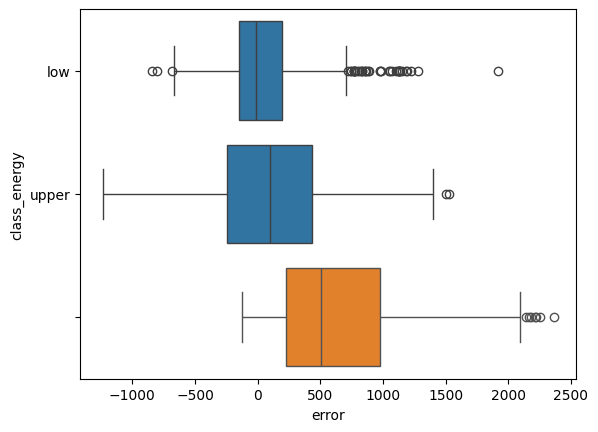

In [354]:
sns.boxplot(data = df_pred, x = 'error', y = 'class_energy')
sns.boxplot(data = df_pred, x = 'y_pred')

# **MODELO FINAL**

In [355]:
from scipy.stats import loguniform
import numpy as np

# Creamos la clase de SVR
params = {
    'svm__C': loguniform(100, 1000),  # Parámetro de regularización
    'svm__gamma': [1, 0.02, 'scale', 'auto']  # Parámetro del kernel
}

# Construimos el pipeline
pipe = Pipeline([
    ('scale', scaler),
    ('svm', SVR())  # Aquí configuramos el estimador SVM
])

svr_hpo = RandomizedSearchCV(pipe, params, n_iter=90, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1, random_state=100472097)

# Iniciamos el tiempo de entrenamiento
start_time = time.time()

# Entrenamos el modelo
svr_hpo.fit(x_train, y_train)

# Calculamos el tiempo de entrenamiento
training_time = time.time() - start_time

# Evaluamos el modelo en el conjunto de prueba
print("Los mejores puntajes encontrados fueron:", -svr_hpo.best_score_)
print("Los mejores hiperparámetros encontrados fueron:", svr_hpo.best_params_)
predictions = svr_hpo.predict(x_test)  # Predicciones
error_rmse_svm_final = np.sqrt(mean_squared_error(y_test, predictions))
error_mae_svm_final = mean_absolute_error(y_test, predictions)

print('Como errores:\n\tRMSE\t= {:.2f}\n\tMAE\t= {:.2f}'.format(error_rmse_svm_final, error_mae_svm_final))
print('El tiempo de ejecución ha sido de {:.2f} segundos'.format(training_time))

Los mejores puntajes encontrados fueron: 156175.22486190553
Los mejores hiperparámetros encontrados fueron: {'svm__C': 720.340370764552, 'svm__gamma': 0.02}
Como errores:
	RMSE	= 386.54
	MAE	= 282.09
El tiempo de ejecución ha sido de 25.62 segundos


In [356]:
def generar_x_y(dataframe):
    x = dataframe.drop(columns=[ "energy", "datetime"]).copy()
    y = dataframe["energy"].copy()
    
    return x, y

wind_ava = pd.read_csv('wind_ava.csv.gz', compression="gzip", sep=",")
sotavento_columns = [col for col in wind_ava.columns if ".13" in col]
sotavento_columns.insert(0, "datetime")
sotavento_columns.append("energy")
dataset_sotavento_copy_final = wind_ava[sotavento_columns].copy()

x_completo,y_completo = generar_x_y(dataset_sotavento_copy_final)


modelo_final = svr_hpo.fit(x_completo, y_completo)

In [357]:
from joblib import dump

dump(svr_hpo, "modelo_final.pkl")

['modelo_final.pkl']